<h1> <center> Transcriptomics of symptomatic hosts, potato and mint,$\\$ and asymptomatic host, mustard, during infection with host-adapted isolates of $Verticillium\smallskip dahliae$ </center></h1>         

#### <h1> Authors: David Linnard Wheeler| Jeness Scott | Jeremiah Kam Sung Dung | Dennis Johnson </h1>         

## Table of Contents: <a class="anchor" id="toc-q"></a>
* [Objectives](#first-q)
* [Hypotheses](#second-q)
* [Experimental design](#third-q)
* [Matierial and Methods](#fourth-q)
* [Open data](#fifth-q)
* [Curate data](#sixth-q)
* [Summary statistics](#seventh-q)
* [Exploratory data analyses](#eighth-q)
* [Diagnostics](#nineth-q)
* [Parametric analyses: differential expression analysis](#tenth-q)
* [Visualization](#eleventh-q)
* [Export data](#twelveth-q)
* [Graveyard](#thirteenth-q)
* [Resources](#fourteenth-q)

### Objectives <a class="anchor" id="first-q"></a>  
[Back to Table of Contents](#toc-q)

* Characterize the differentially expressed genes involved in symptomatic (potato and mint) and asymptomatic interactions (mustard) between hosts and $Verticillium\; dahliae$ 

### Hypotheses <a class="anchor" id="second-q"></a>  
[Back to Table of Contents](#toc-q)

* **Science $H_o$ 1**: There are no differentially expressed genes (i) between symptomatic and asymptomatic hosts, (ii) between isolates within a host, and (iii) between hosts within an isolate.
* **Science $H_o$ 2**: Symptomatic and asymptomatic hosts exhibit similar responses to $V.\; dahliae$ infection
* **Science $H_o$ 3**: Gene expression of $V.\;dahliae$ does not differ accross fungal strains or between asymptomatic and symptomatic hosts
* **Statistical $H_o$**: 
    * Observed variation in DEG across treatments represents random variation, not systematic effects of hosts or isolates Variation in the DEG is unrelated to variation in the hosts and isolates and is no greater than expected by chance or sampling error.
    * More formally:
    
    $K_{ij} \sim NB(\mu_{ij}, \alpha_i)$
    
    where the counts, $K_{ij}$ for each gene, $i$, and sample, $j$, follow a negative binomial with the mean,$\mu_{ij}$, and dispersion parameter for each gene, $\alpha_i$. The dispersion parameter,$\alpha_i$, describes  the relationship between variance of an observed count and its mean value- the expected distance of the observed count from its mean. The mean,$\mu_{ij}$, can be decomposed into a sample-specific size factor, $s_j$, and a parameter,$q_{ij}$, that is proportional to the expected concentation of transcripts for sample $j$:
    
    $\mu_{ij} = s_j q_{ij}$
    
    Log2 fold changes for gene $i$ in each column of the model matrix, $X$,are provided by the coefficients, $\beta_i$:
    
    $log_2(q_{ij}) = x_{j.}\beta_i$
    
    * In short, the effect sizes between the groups are 0.

### Experimental design<a class="anchor" id="third-q"></a>  
[Back to Table of Contents](#toc-q)

* **Treatment structure**: 2 way factorial
    * **Independent variables**: 
        * 3 hosts:
            1. Potato 'Russet Burbank'
            2. Mint 'Black Mitchum'
            3. Brown mustard 'ISCI 99'
        * 3 fungi:
            1. $Verticillium\; dahliae\; 653$
            2. $Verticillium\; dahliae\; 111$
            3. Non-inoculated control
        * 1 time point:
            * 10 days after inoculation
        * 3 replicates
    * **Dependent variables**:
        * Constructs: 
            * Gene expression
        * Variables: 
            * Counts of RNA transcripts
            
* **Design structure**: randomized complete block design    
* **Observational unit**: plant
* **Experimental unit**: plant
* **Samples**: whole plants
* **Data**: 
    * RNA quantity and quality
    * Counts of RNA transcripts
* **Analysis**: 
    * Differential gene expression analyses        

### Materials and Methods<a class="anchor" id="fourth-q"></a>  
[Back to Table of Contents](#toc-q)

* **Inoculum preparation for root dips (3.5"pot)**:
    * Inoculum for isolates 653 and 111:
       * 180 plants/3 isolates = 60 plants/isolate * 100 ml/plant (Dung et al. 2010) = 6000 ml = 6 L inoculum
       * 6 L of 10$^6$ conidia/ml inoculum is needed
       * 6 L/200 ml/flask = 30 flasks 
    
    * Trial one planted: 5/1/2018
    * Trial one inoculated: 5/19/2018
    * First Harvest: potato, mint, and mustards harvested @ 10 dpi on 5/29/2018

### Open data<a class="anchor" id="fifth-q"></a>  
[Back to Table of Contents](#toc-q)

* **Install and invoke packages**

In [1]:
if (!requireNamespace("BiocManager", quietly = TRUE))
    install.packages("BiocManager")
BiocManager::install("DEFormats", version = "3.8")

Bioconductor version 3.8 (BiocManager 1.30.4), R 3.5.2 (2018-12-20)
Installing package(s) 'DEFormats'



The downloaded binary packages are in
	/var/folders/8c/7fwkqlvd4ps_rj6zf9lr_xcw0000gn/T//RtmptF4nug/downloaded_packages


Update old packages: 'annotate', 'assertthat', 'BiocInstaller', 'callr', 'cli',
  'colorspace', 'gtable', 'highr', 'knitr', 'lazyeval', 'openssl', 'pkgbuild',
  'processx', 'purrr', 'Rcpp', 'RcppArmadillo', 'readxl', 'rgdal', 'rlang',
  'rmarkdown', 'rstudioapi', 'spam', 'sys', 'tibble', 'tinytex', 'XML',
  'diffobj', 'e1071', 'fs', 'git2r', 'Matrix', 'mgcv', 'zoo'


In [2]:
if (!requireNamespace("BiocManager", quietly = TRUE))
    install.packages("BiocManager")
BiocManager::install("apeglm", version = "3.8")

Bioconductor version 3.8 (BiocManager 1.30.4), R 3.5.2 (2018-12-20)
Installing package(s) 'apeglm'



The downloaded binary packages are in
	/var/folders/8c/7fwkqlvd4ps_rj6zf9lr_xcw0000gn/T//RtmptF4nug/downloaded_packages


Update old packages: 'annotate', 'assertthat', 'BiocInstaller', 'callr', 'cli',
  'colorspace', 'gtable', 'highr', 'knitr', 'lazyeval', 'openssl', 'pkgbuild',
  'processx', 'purrr', 'Rcpp', 'RcppArmadillo', 'readxl', 'rgdal', 'rlang',
  'rmarkdown', 'rstudioapi', 'spam', 'sys', 'tibble', 'tinytex', 'XML',
  'diffobj', 'e1071', 'fs', 'git2r', 'Matrix', 'mgcv', 'zoo'


In [102]:
.libPaths()

[1] "/Users/davidwheeler/Library/R/3.5/library"                     
[2] "/Library/Frameworks/R.framework/Versions/3.5/Resources/library"

In [1]:
library("readxl")
library("data.table")
library("tibble")
library("eulerr")
library("apeglm")
library("DESeq2")
library("edgeR")
library("DEFormats")
library("dplyr")
library("ggplot2")
library("reshape2")
library("pheatmap")
library("RColorBrewer")
library("PoiClaClu")
library("ggbeeswarm")
library("EnhancedVolcano")
library("devtools")
library("gridExtra")
library("grid")
library("cowplot")
library("genefilter")
library("viridis")
library("VennDiagram")
library("prob")
library("seqinr")
library("stringr")

Loading required package: S4Vectors

Loading required package: stats4

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
    union, unique, unsplit, which, which.max, which.min



Attaching package: ‘S4Vectors’


The

* Grab working directory

In [2]:
getwd()

[1] "/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/SCRIPTS"

* Set working directory

In [3]:
setwd("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/DATA/R_FILES/Reads/")

* **Open data**

Fragments

In [4]:
DF = read.csv("Fungal_reads.csv",header=T)

Gene names

In [5]:
gnDF = read.csv("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/DATA/R_FILES/Gene_names/DGE_GENE_NAME/Vd_DEG_genename.csv",
                header=T)

In [6]:
names(gnDF)[2]<-"id"
names(gnDF)[3]<-"Comparison"
names(gnDF)[6]<-"KO.Name"
names(gnDF)[10]<-"Hit1_acc"

Sequences

In [7]:
fastafile <- read.fasta(file = "/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/DATA/R_FILES/Sequences/Vd_gene.fasta", 
                       seqtype = "AA",as.string = TRUE, set.attributes = FALSE)


Gene Ontology

In [8]:
GO = read.csv("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/DATA/R_FILES/Gene_ontology/Vd_gene.goannot.csv",
                header=T)


### Curate data<a class="anchor" id="sixth-q"></a>  
[Back to Table of Contents](#toc-q)

* **Set first column to index**

In [9]:
DF_1 <- data.frame(DF[,-1], row.names = DF[,1])

In [10]:
head(DF_1)

,S1_1_2_2,S1_1_2_3,S1_1_2_6,S1_2_2_1,S1_2_2_2,S1_2_2_4,S3_2_2_1,S3_1_2_2,S3_1_2_4,S3_1_2_6,S3_2_2_3,S3_2_2_6,S2_1_2_1,S2_1_2_4,S2_1_2_5,S2_2_2_2,S2_2_2_5,S2_2_2_9
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
mRNA_481,12,2,12,4,3,14,2,1,1,3,3,2,12,12,7,24,6,27
mRNA_7278,22,41,16,17,20,29,12,14,9,4,50,29,11,27,26,62,17,21
mRNA_2056,3,0,3,1,2,8,2,0,3,1,6,4,4,9,4,11,3,11
mRNA_7241,1,2,0,0,5,1,0,0,0,0,3,0,0,0,6,2,4,0
mRNA_356,0,1,0,0,0,1,1,0,3,2,8,4,2,0,2,1,2,3
mRNA_9280,1,0,2,0,3,1,1,0,1,0,3,0,1,2,1,13,1,7


* **Reorder columns**

In [11]:
DF_1 <- DF_1[,c(1,2,3,
               4,5,6,
               13,14,15,
               16,17,18,
               8,9,10,
               7,11,12)]

* **For mint and mustard only, round floats/decimals to integer counts: since these data were generated $de\; novo$ decimals are abound**

In [12]:
DF = round(DF_1, digits = 0)

* **Create DGEList Object**

> * Convert dataframe to matrix

In [13]:
df = data.matrix(DF_1)

* **Vector for column/treatment names**

In [14]:
group = rep(c("S_653","S_111",
              "M_653","M_111",
              "B_653", "B_111"),each=3)

In [15]:
dge = DGEList(df, group = group)

In [16]:
dge

,S1_1_2_2,S1_1_2_3,S1_1_2_6,S1_2_2_1,S1_2_2_2,S1_2_2_4,S2_1_2_1,S2_1_2_4,S2_1_2_5,S2_2_2_2,S2_2_2_5,S2_2_2_9,S3_1_2_2,S3_1_2_4,S3_1_2_6,S3_2_2_1,S3_2_2_3,S3_2_2_6
mRNA_481,12,2,12,4,3,14,12,12,7,24,6,27,1,1,3,2,3,2
mRNA_7278,22,41,16,17,20,29,11,27,26,62,17,21,14,9,4,12,50,29
mRNA_2056,3,0,3,1,2,8,4,9,4,11,3,11,0,3,1,2,6,4
mRNA_7241,1,2,0,0,5,1,0,0,6,2,4,0,0,0,0,0,3,0
mRNA_356,0,1,0,0,0,1,2,0,2,1,2,3,0,3,2,1,8,4
mRNA_9280,1,0,2,0,3,1,1,2,1,13,1,7,0,1,0,1,3,0
mRNA_7007,27,18,10,21,31,37,19,26,20,82,27,64,10,21,11,17,76,27
mRNA_4722,0,0,0,1,0,4,0,1,0,3,0,6,4,0,0,0,1,0
mRNA_1656,1,1,0,1,0,0,0,0,1,9,6,4,0,0,1,1,4,1
mRNA_9928,2,2,6,2,2,6,10,9,2,28,6,22,1,0,5,2,20,2


* **Coerce DGElist to DESeqDataSet**

In [17]:
dds = as.DESeqDataSet(dge)

In [18]:
dds

class: DESeqDataSet 
dim: 10565 18 
metadata(1): version
assays(1): counts
rownames(10565): mRNA_481 mRNA_7278 ... mRNA_5196 mRNA_3120
rowData names(0):
colnames(18): S1_1_2_2 S1_1_2_3 ... S3_2_2_3 S3_2_2_6
colData names(3): group lib.size norm.factors

### Summary Statistics<a class="anchor" id="seventh-q"></a>  
[Back to Table of Contents](#toc-q)

**The total number of DEGS per comparison**

In [93]:
table(DEGS$Comparison)


B1vM1 B6vS6 M6vM1 M6vS6 S1vM1 S1vS6 
   25     2     2    16    17     1 

Tabulate DEG data (Comparison - basemean -direction of regulation - log$_2$-fold change - $p$-value - adjusted $p$-value - gene name - function)

**DEGs from M653 vs S653**

In [94]:
M653vS653_gn = subset(M653vS653_GeneNames, Comparison == "S6vM6") # This is reversed but does not matter since we just want the name

* Order genes by fold change

In [95]:
table_M6vS6 <- (M653vS653_gn[order((-M653vS653_gn$log2FoldChange)),c(9,1,2,3,6,7,16)])

- Round digits

In [96]:
table_M6vS6$baseMean <- round(table_M6vS6$baseMean, 1)
table_M6vS6$log2FoldChange <- round(table_M6vS6$log2FoldChange, 1)
table_M6vS6$pvalue <- round(table_M6vS6$pvalue, 7)
table_M6vS6$padj <- round(table_M6vS6$padj, 7)

- Format columns

> - Comparison

In [97]:
table_M6vS6$Comparison = "653"

* Host

In [98]:
table_M6vS6$Host = "Mentha x piperita vs Solanum tuberosum"

- Gene function

In [99]:
table_M6vS6$Function = NA

> - Sequence

In [100]:
table_M6vS6$Sequence = NA

- Reorder columns

In [101]:
table_M6vS6 = table_M6vS6[,c(8,1,3:7,2,9:10)]

- Grab top 5 genes

In [102]:
Up_M6vS6 = head(table_M6vS6,n=5)

> - Add column for regulation status

In [103]:
Up_M6vS6$Regulation = "up"

- Grab botton 5 genes (or $\leq\;5$)

In [104]:
Down_M6vS6 = tail(table_M6vS6,n=3)

> - Add column for regulation status

In [105]:
Down_M6vS6$Regulation = "down"

- Table for mint 653 vs potato 653

In [106]:
Table_M6vS6 = rbind(Up_M6vS6,Down_M6vS6)

In [107]:
Table_M6vS6

,Host,Comparison,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence,Regulation
25,Mentha x piperita vs Solanum tuberosum,653,31.9,5.2,0.00e+00,0.0000009,TERA_ASPTN,mRNA_190,NA,NA,up
5,Mentha x piperita vs Solanum tuberosum,653,13.4,4.8,3.00e-07,0.0000220,AYG1_ASPFU,mRNA_10198,NA,NA,up
55,Mentha x piperita vs Solanum tuberosum,653,35.5,4.5,0.00e+00,0.0000000,-,mRNA_6472,NA,NA,up
75,Mentha x piperita vs Solanum tuberosum,653,39.1,4.1,0.00e+00,0.0000010,THR1_COLOR,mRNA_8909,NA,NA,up
50,Mentha x piperita vs Solanum tuberosum,653,114.2,3.4,0.00e+00,0.0000000,YL54_SCHPO,mRNA_621,NA,NA,up
62,Mentha x piperita vs Solanum tuberosum,653,17.1,-2.1,8.40e-06,0.0004527,-,mRNA_7744,NA,NA,down
65,Mentha x piperita vs Solanum tuberosum,653,16.5,-2.4,1.83e-05,0.0008340,MEP3_YEAST,mRNA_8402,NA,NA,down
19,Mentha x piperita vs Solanum tuberosum,653,11.3,-2.8,2.30e-06,0.0001362,GLNA_NEUCR,mRNA_1402,NA,NA,down


- Rearrange columns

In [108]:
Table_M6vS6 = Table_M6vS6[,c(1:2,11,3:10)]

In [109]:
Table_M6vS6

,Host,Comparison,Regulation,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence
25,Mentha x piperita vs Solanum tuberosum,653,up,31.9,5.2,0.00e+00,0.0000009,TERA_ASPTN,mRNA_190,NA,NA
5,Mentha x piperita vs Solanum tuberosum,653,up,13.4,4.8,3.00e-07,0.0000220,AYG1_ASPFU,mRNA_10198,NA,NA
55,Mentha x piperita vs Solanum tuberosum,653,up,35.5,4.5,0.00e+00,0.0000000,-,mRNA_6472,NA,NA
75,Mentha x piperita vs Solanum tuberosum,653,up,39.1,4.1,0.00e+00,0.0000010,THR1_COLOR,mRNA_8909,NA,NA
50,Mentha x piperita vs Solanum tuberosum,653,up,114.2,3.4,0.00e+00,0.0000000,YL54_SCHPO,mRNA_621,NA,NA
62,Mentha x piperita vs Solanum tuberosum,653,down,17.1,-2.1,8.40e-06,0.0004527,-,mRNA_7744,NA,NA
65,Mentha x piperita vs Solanum tuberosum,653,down,16.5,-2.4,1.83e-05,0.0008340,MEP3_YEAST,mRNA_8402,NA,NA
19,Mentha x piperita vs Solanum tuberosum,653,down,11.3,-2.8,2.30e-06,0.0001362,GLNA_NEUCR,mRNA_1402,NA,NA


- Rename column headers

In [110]:
names(Table_M6vS6)[4] = "Base mean"
names(Table_M6vS6)[5] = "Log2 fold change"
names(Table_M6vS6)[6] = "p-value"
names(Table_M6vS6)[7] = "adjusted p-value"
names(Table_M6vS6)[8] = "Gene name"
names(Table_M6vS6)[9] = "Gene ID"
names(Table_M6vS6)[10] = "Function"
names(Table_M6vS6)[11] = "Sequence"

In [111]:
Table_M6vS6

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
25,Mentha x piperita vs Solanum tuberosum,653,up,31.9,5.2,0.00e+00,0.0000009,TERA_ASPTN,mRNA_190,NA,NA
5,Mentha x piperita vs Solanum tuberosum,653,up,13.4,4.8,3.00e-07,0.0000220,AYG1_ASPFU,mRNA_10198,NA,NA
55,Mentha x piperita vs Solanum tuberosum,653,up,35.5,4.5,0.00e+00,0.0000000,-,mRNA_6472,NA,NA
75,Mentha x piperita vs Solanum tuberosum,653,up,39.1,4.1,0.00e+00,0.0000010,THR1_COLOR,mRNA_8909,NA,NA
50,Mentha x piperita vs Solanum tuberosum,653,up,114.2,3.4,0.00e+00,0.0000000,YL54_SCHPO,mRNA_621,NA,NA
62,Mentha x piperita vs Solanum tuberosum,653,down,17.1,-2.1,8.40e-06,0.0004527,-,mRNA_7744,NA,NA
65,Mentha x piperita vs Solanum tuberosum,653,down,16.5,-2.4,1.83e-05,0.0008340,MEP3_YEAST,mRNA_8402,NA,NA
19,Mentha x piperita vs Solanum tuberosum,653,down,11.3,-2.8,2.30e-06,0.0001362,GLNA_NEUCR,mRNA_1402,NA,NA


**DEGs from B653 vs S653**

In [112]:
B653vS653_gn = subset(B653vS653_GeneNames, Comparison == "S6vB6")# The order of the gene names here does not reflect the order of the analyses below

- Order genes by fold change

In [113]:
table_B653vS653 <- (B653vS653_gn[order((-B653vS653_gn$log2FoldChange)),c(9,1,2,3,6,7,16)])

- Round digits

In [114]:
table_B653vS653$baseMean <- round(table_B653vS653$baseMean, 1)
table_B653vS653$log2FoldChange <- round(table_B653vS653$log2FoldChange, 1)
table_B653vS653$pvalue <- round(table_B653vS653$pvalue, 7)
table_B653vS653$padj <- round(table_B653vS653$padj, 7)

- Format columns

> - Comparisons

In [115]:
table_B653vS653$Comparison = "653"

> - Host

In [116]:
table_B653vS653$Host = "Brassica juncea vs Solanum tuberosum"

> - Gene function

In [117]:
table_B653vS653$Function = NA

> - Sequence

In [118]:
table_B653vS653$Sequence = NA

> - Column for regulation status

In [119]:
table_B653vS653$Regulation = "up"

In [120]:
table_B653vS653

,Comparison,id,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,Host,Function,Sequence,Regulation
12,653,mRNA_1341,40.6,5.2,0,1e-07,-,Brassica juncea vs Solanum tuberosum,NA,NA,up
9,653,mRNA_10347,67.6,3.8,0,0e+00,YDDQ_BACSU,Brassica juncea vs Solanum tuberosum,NA,NA,up


- Rearrange columns

In [121]:
Table_B653vS653= table_B653vS653[,c(8,1,11,3:7,2,9:10)]

In [122]:
Table_B653vS653

,Host,Comparison,Regulation,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence
12,Brassica juncea vs Solanum tuberosum,653,up,40.6,5.2,0,1e-07,-,mRNA_1341,NA,NA
9,Brassica juncea vs Solanum tuberosum,653,up,67.6,3.8,0,0e+00,YDDQ_BACSU,mRNA_10347,NA,NA


- Rename column headers

In [123]:
names(Table_B653vS653)[4] = "Base mean"
names(Table_B653vS653)[5] = "Log2 fold change"
names(Table_B653vS653)[6] = "p-value"
names(Table_B653vS653)[7] = "adjusted p-value"
names(Table_B653vS653)[8] = "Gene name"
names(Table_B653vS653)[9] = "Gene ID"
names(Table_B653vS653)[10] = "Function"
names(Table_B653vS653)[11] = "Sequence"

In [124]:
Table_B653vS653

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
12,Brassica juncea vs Solanum tuberosum,653,up,40.6,5.2,0,1e-07,-,mRNA_1341,NA,NA
9,Brassica juncea vs Solanum tuberosum,653,up,67.6,3.8,0,0e+00,YDDQ_BACSU,mRNA_10347,NA,NA


**DEGs from S111 vs M111**

In [125]:
S111vsM111_gn = subset(S111vM111_GeneNames, Comparison == "S1vM1")

- Order genes by fold change

In [126]:
table_S111vsM111 <- (S111vsM111_gn[order((-S111vsM111_gn$log2FoldChange)),c(9,1,2,3,6,7,16)])

- Round Digits

In [127]:
table_S111vsM111$baseMean <- round(table_S111vsM111$baseMean, 1)
table_S111vsM111$log2FoldChange <- round(table_S111vsM111$log2FoldChange, 1)
table_S111vsM111$pvalue <- round(table_S111vsM111$pvalue, 7)
table_S111vsM111$padj <- round(table_S111vsM111$padj, 7)

- Format columns

> - By Columns

In [128]:
table_S111vsM111$Comparison = "111"

> - Host

In [129]:
table_S111vsM111$Host = "Solanum tuberosum vs Mentha x piperita"

> - Gene function

In [130]:
table_S111vsM111$Function = NA

> - Sequence

In [131]:
table_S111vsM111$Sequence = NA

- Reorder columns

In [132]:
table_S111vsM111 = table_S111vsM111[,c(8,1,3:7,2,9:10)]

- Grab top 5 genes (or $\leq\;5$)

In [133]:
Up_S111vsM111 = head(table_S111vsM111,n=3)

> - Column for regulation

In [134]:
Up_S111vsM111$Regulation = "up"

- Grab bottom 5 DEGs

In [135]:
Down_S111vsM111 = tail(table_S111vsM111,n=5)

> - Column for regulation

In [136]:
Down_S111vsM111$Regulation = "down"

- Table $Solanum\;tuberosum$ 111 vs $Mentha\;x\;piperita$ 111

In [137]:
Table_S111vsM111 = rbind(Up_S111vsM111,Down_S111vsM111)

- Rearrange columns

In [138]:
Table_S111vsM111 = Table_S111vsM111[,c(1:2,11,3:10)]

In [139]:
Table_S111vsM111

,Host,Comparison,Regulation,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence
78,Solanum tuberosum vs Mentha x piperita,111,up,14.6,2.4,2.00e-07,0.0000303,-,mRNA_9290,NA,NA
28,Solanum tuberosum vs Mentha x piperita,111,up,14.3,2.1,1.18e-05,0.0009494,RCF2_SCHPO,mRNA_1922,NA,NA
11,Solanum tuberosum vs Mentha x piperita,111,up,19.8,1.8,1.11e-05,0.0009484,-,mRNA_1128,NA,NA
26,Solanum tuberosum vs Mentha x piperita,111,down,31.9,-3.7,0.00e+00,0.0000000,TERA_ASPTN,mRNA_190,NA,NA
74,Solanum tuberosum vs Mentha x piperita,111,down,7.2,-4.1,1.09e-05,0.0009484,SCYD_COLOR,mRNA_8635,NA,NA
22,Solanum tuberosum vs Mentha x piperita,111,down,8.0,-4.5,1.00e-07,0.0000276,ARP2_ASPFU,mRNA_183,NA,NA
6,Solanum tuberosum vs Mentha x piperita,111,down,13.4,-4.7,1.00e-07,0.0000158,AYG1_ASPFU,mRNA_10198,NA,NA
53,Solanum tuberosum vs Mentha x piperita,111,down,35.5,-5.1,0.00e+00,0.0000000,-,mRNA_6472,NA,NA


- Rename column headers

In [140]:
names(Table_S111vsM111)[4] = "Base mean"
names(Table_S111vsM111)[5] = "Log2 fold change"
names(Table_S111vsM111)[6] = "p-value"
names(Table_S111vsM111)[7] = "adjusted p-value"
names(Table_S111vsM111)[8] = "Gene name"
names(Table_S111vsM111)[9] = "Gene ID"
names(Table_S111vsM111)[10] = "Function"
names(Table_S111vsM111)[11] = "Sequence"

In [141]:
Table_S111vsM111

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
78,Solanum tuberosum vs Mentha x piperita,111,up,14.6,2.4,2.00e-07,0.0000303,-,mRNA_9290,NA,NA
28,Solanum tuberosum vs Mentha x piperita,111,up,14.3,2.1,1.18e-05,0.0009494,RCF2_SCHPO,mRNA_1922,NA,NA
11,Solanum tuberosum vs Mentha x piperita,111,up,19.8,1.8,1.11e-05,0.0009484,-,mRNA_1128,NA,NA
26,Solanum tuberosum vs Mentha x piperita,111,down,31.9,-3.7,0.00e+00,0.0000000,TERA_ASPTN,mRNA_190,NA,NA
74,Solanum tuberosum vs Mentha x piperita,111,down,7.2,-4.1,1.09e-05,0.0009484,SCYD_COLOR,mRNA_8635,NA,NA
22,Solanum tuberosum vs Mentha x piperita,111,down,8.0,-4.5,1.00e-07,0.0000276,ARP2_ASPFU,mRNA_183,NA,NA
6,Solanum tuberosum vs Mentha x piperita,111,down,13.4,-4.7,1.00e-07,0.0000158,AYG1_ASPFU,mRNA_10198,NA,NA
53,Solanum tuberosum vs Mentha x piperita,111,down,35.5,-5.1,0.00e+00,0.0000000,-,mRNA_6472,NA,NA


**DEGs from B111 vs M111**

In [142]:
B111vM111_gn = subset(B111vM111_GeneNames, Comparison == "M1vB1") # Order does not reflect comparisons below

In [143]:
table_B111vM111 <- (B111vM111_gn[order((-B111vM111_gn$log2FoldChange)),c(9,1,2,3,6,7,16)])

- Round digits

In [144]:
table_B111vM111$baseMean <- round(table_B111vM111$baseMean, 1)
table_B111vM111$log2FoldChange <- round(table_B111vM111$log2FoldChange, 1)
table_B111vM111$pvalue <- round(table_B111vM111$pvalue, 7)
table_B111vM111$padj <- round(table_B111vM111$padj, 7)

- Format columns

> - By Columns

In [145]:
table_B111vM111$Comparison = "111"

- Host

In [146]:
table_B111vM111$Host = "Brassica juncea vs Mentha x piperita"

> - Gene function

In [147]:
table_B111vM111$Function = NA

> - Sequence

In [148]:
table_B111vM111$Sequence = NA

- Reorder columns

In [149]:
table_B111vM111 = table_B111vM111[,c(8,1,3:7,2,9:10)]

>- Grab top 5 genes

In [150]:
Up_B111vM111 = head(table_B111vM111,n=5)

> - Column for regulation

In [151]:
Up_B111vM111$Regulation = "up"

- Grab bottom 5 DEGs

In [152]:
Down_B111vM111 = tail(table_B111vM111,n=5)

> - Column for regulation

In [153]:
Down_B111vM111$Regulation = "down"

> - Column for regulation

Table $Brassica\;juncea$ 111 vs $Mentha\;x\;spicata$ 111

In [154]:
Table_B111vM111 = rbind(Up_B111vM111,Down_B111vM111)

In [155]:
Table_B111vM111 = Table_B111vM111[,c(1:2,11,3:10)]

In [156]:
Table_B111vM111

,Host,Comparison,Regulation,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence
17,Brassica juncea vs Mentha x piperita,111,up,12.7,5.5,0e+00,6.00e-07,-,mRNA_1342,NA,NA
15,Brassica juncea vs Mentha x piperita,111,up,40.6,5.4,0e+00,0.00e+00,-,mRNA_1341,NA,NA
37,Brassica juncea vs Mentha x piperita,111,up,7.5,3.4,0e+00,3.30e-06,BFR1_SCHPO,mRNA_3553,NA,NA
79,Brassica juncea vs Mentha x piperita,111,up,7.7,3.2,2e-07,3.99e-05,DUS4_SCHPO,mRNA_9681,NA,NA
7,Brassica juncea vs Mentha x piperita,111,up,67.6,2.6,0e+00,0.00e+00,YDDQ_BACSU,mRNA_10347,NA,NA
29,Brassica juncea vs Mentha x piperita,111,down,7.2,-3.5,2e-07,4.94e-05,YUC7_ARATH,mRNA_2656,NA,NA
33,Brassica juncea vs Mentha x piperita,111,down,19.9,-3.6,4e-07,6.29e-05,-,mRNA_299,NA,NA
4,Brassica juncea vs Mentha x piperita,111,down,13.4,-3.6,0e+00,1.00e-07,AYG1_ASPFU,mRNA_10198,NA,NA
32,Brassica juncea vs Mentha x piperita,111,down,7.7,-3.7,1e-07,2.00e-05,PLYF_ASPFC,mRNA_2785,NA,NA
68,Brassica juncea vs Mentha x piperita,111,down,12.7,-5.8,0e+00,1.00e-07,-,mRNA_8458,NA,NA


- Rename columns

In [157]:
names(Table_B111vM111)[4] = "Base mean"
names(Table_B111vM111)[5] = "Log2 fold change"
names(Table_B111vM111)[6] = "p-value"
names(Table_B111vM111)[7] = "adjusted p-value"
names(Table_B111vM111)[8] = "Gene name"
names(Table_B111vM111)[9] = "Gene ID"
names(Table_B111vM111)[10] = "Function"
names(Table_B111vM111)[11] = "Sequence"

In [158]:
Table_B111vM111

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
17,Brassica juncea vs Mentha x piperita,111,up,12.7,5.5,0e+00,6.00e-07,-,mRNA_1342,NA,NA
15,Brassica juncea vs Mentha x piperita,111,up,40.6,5.4,0e+00,0.00e+00,-,mRNA_1341,NA,NA
37,Brassica juncea vs Mentha x piperita,111,up,7.5,3.4,0e+00,3.30e-06,BFR1_SCHPO,mRNA_3553,NA,NA
79,Brassica juncea vs Mentha x piperita,111,up,7.7,3.2,2e-07,3.99e-05,DUS4_SCHPO,mRNA_9681,NA,NA
7,Brassica juncea vs Mentha x piperita,111,up,67.6,2.6,0e+00,0.00e+00,YDDQ_BACSU,mRNA_10347,NA,NA
29,Brassica juncea vs Mentha x piperita,111,down,7.2,-3.5,2e-07,4.94e-05,YUC7_ARATH,mRNA_2656,NA,NA
33,Brassica juncea vs Mentha x piperita,111,down,19.9,-3.6,4e-07,6.29e-05,-,mRNA_299,NA,NA
4,Brassica juncea vs Mentha x piperita,111,down,13.4,-3.6,0e+00,1.00e-07,AYG1_ASPFU,mRNA_10198,NA,NA
32,Brassica juncea vs Mentha x piperita,111,down,7.7,-3.7,1e-07,2.00e-05,PLYF_ASPFC,mRNA_2785,NA,NA
68,Brassica juncea vs Mentha x piperita,111,down,12.7,-5.8,0e+00,1.00e-07,-,mRNA_8458,NA,NA


**DEGs from S111 vs S653**

In [159]:
S111vS653_gn = subset(S111vS653_GeneNames, Comparison == "S6vS1") # Order does not reflect comparisons below

- Order genes by fold change

In [160]:
table_S111vS653 <- (S111vS653_gn[order((-S111vS653_gn$log2FoldChange)),c(9,1,2,3,6,7,16)])

- Round digits

In [161]:
table_S111vS653$baseMean <- round(table_S111vS653$baseMean, 1)
table_S111vS653$log2FoldChange <- round(table_S111vS653$log2FoldChange, 1)
table_S111vS653$pvalue <- round(table_S111vS653$pvalue, 7)
table_S111vS653$padj <- round(table_S111vS653$padj, 7)

- Format columns

> - By Columns

In [162]:
table_S111vS653$Comparison = "111 vs 653"

- Host

In [163]:
table_S111vS653$Host = "Solanum tuberosum"

> - Gene function

In [164]:
table_S111vS653$Function = NA

> - Sequence

In [165]:
table_S111vS653$Sequence = NA

- Column for regulation

In [166]:
table_S111vS653$Regulation = "up"

- Reorder columns

In [167]:
table_S111vS653=table_S111vS653[,c(8,1,11,3:7,2,9:10)]

In [168]:
table_S111vS653

,Host,Comparison,Regulation,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence
67,Solanum tuberosum,111 vs 653,up,20.3,3,0,0.0001275,AOX_PODAS,mRNA_8451,NA,NA


- Rename columns

In [169]:
names(table_S111vS653)[4] = "Base mean"
names(table_S111vS653)[5] = "Log2 fold change"
names(table_S111vS653)[6] = "p-value"
names(table_S111vS653)[7] = "adjusted p-value"
names(table_S111vS653)[8] = "Gene name"
names(table_S111vS653)[9] = "Gene ID"
names(table_S111vS653)[10] = "Function"
names(table_S111vS653)[11] = "Sequence"

Table for $Solanum\;tuberosum$ 111 vs $Solanum\;tuberosum$ 653

In [170]:
Table_S111vS653 = table_S111vS653

In [171]:
Table_S111vS653

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
67,Solanum tuberosum,111 vs 653,up,20.3,3,0,0.0001275,AOX_PODAS,mRNA_8451,NA,NA


**DEGs from M653 vs M111**

In [172]:
M653vM111_gn = subset(M653vM111_GeneNames, Comparison == "M6vM1")

- Order genes by fold change

In [173]:
table_M653vM111 <- (M653vM111_gn[order((-M653vM111_gn$log2FoldChange)),c(9,1,2,3,6,7,16)])

- Round digits

In [174]:
table_M653vM111$baseMean <- round(table_M653vM111$baseMean, 1)
table_M653vM111$log2FoldChange <- round(table_M653vM111$log2FoldChange, 1)
table_M653vM111$pvalue <- round(table_M653vM111$pvalue, 7)
table_M653vM111$padj <- round(table_M653vM111$padj, 7)

- Format columns

> - By columns

In [175]:
table_M653vM111$Comparison = "653 vs 111"

> - Host

In [176]:
table_M653vM111$Host = "Mentha x piperita"

> - Gene function

In [177]:
table_M653vM111$Function = NA

> - Sequence

In [178]:
table_M653vM111$Sequence = NA

> - Regulation

In [179]:
table_M653vM111$Regulation = "down"

- Reorder columns

In [180]:
table_M653vM111

,Comparison,id,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,Host,Function,Sequence,Regulation
69,653 vs 111,mRNA_8458,12.7,-3.2,0,1.8e-06,-,Mentha x piperita,NA,NA,down


In [181]:
table_M653vM111=table_M653vM111[,c(8,1,11,3:7,2,9:10)]

In [182]:
table_M653vM111

,Host,Comparison,Regulation,baseMean,log2FoldChange,pvalue,padj,Hit1_acc,id,Function,Sequence
69,Mentha x piperita,653 vs 111,down,12.7,-3.2,0,1.8e-06,-,mRNA_8458,NA,NA


* Rename columns

In [183]:
names(table_M653vM111)[4] = "Base mean"
names(table_M653vM111)[5] = "Log2 fold change"
names(table_M653vM111)[6] = "p-value"
names(table_M653vM111)[7] = "adjusted p-value"
names(table_M653vM111)[8] = "Gene name"
names(table_M653vM111)[9] = "Gene ID"
names(table_M653vM111)[10] = "Function"
names(table_M653vM111)[11] = "Sequence"

Table for $Mentha\;x\;piperita$ 653 vs $Mentha\;x\;piperita$ 111

In [184]:
Table_M653vM111 = table_M653vM111

In [185]:
Table_M653vM111

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
69,Mentha x piperita,653 vs 111,down,12.7,-3.2,0,1.8e-06,-,mRNA_8458,NA,NA


**DEGs from B111 vs B653**

No DEGs

**Combine all tables**

In [186]:
names(Table_M6vS6)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"

In [187]:
names(Table_B653vS653)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"

In [188]:
names(Table_S111vsM111)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"

In [189]:
names(Table_B111vM111)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"

In [190]:
names(Table_S111vS653)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"

In [191]:
names(Table_M653vM111)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"

In [192]:
table_all = rbind(Table_M6vS6,
                  Table_B653vS653,
                  Table_S111vsM111,
                  Table_B111vM111,
                  Table_S111vS653,
                  Table_M653vM111)

In [193]:
table_all

,Host,Comparison,Regulation,Base mean,Log2 fold change,p-value,adjusted p-value,Gene name,Gene ID,Function,Sequence
25,Mentha x piperita vs Solanum tuberosum,653,up,31.9,5.2,0.00e+00,0.0000009,TERA_ASPTN,mRNA_190,NA,NA
5,Mentha x piperita vs Solanum tuberosum,653,up,13.4,4.8,3.00e-07,0.0000220,AYG1_ASPFU,mRNA_10198,NA,NA
55,Mentha x piperita vs Solanum tuberosum,653,up,35.5,4.5,0.00e+00,0.0000000,-,mRNA_6472,NA,NA
75,Mentha x piperita vs Solanum tuberosum,653,up,39.1,4.1,0.00e+00,0.0000010,THR1_COLOR,mRNA_8909,NA,NA
50,Mentha x piperita vs Solanum tuberosum,653,up,114.2,3.4,0.00e+00,0.0000000,YL54_SCHPO,mRNA_621,NA,NA
62,Mentha x piperita vs Solanum tuberosum,653,down,17.1,-2.1,8.40e-06,0.0004527,-,mRNA_7744,NA,NA
65,Mentha x piperita vs Solanum tuberosum,653,down,16.5,-2.4,1.83e-05,0.0008340,MEP3_YEAST,mRNA_8402,NA,NA
19,Mentha x piperita vs Solanum tuberosum,653,down,11.3,-2.8,2.30e-06,0.0001362,GLNA_NEUCR,mRNA_1402,NA,NA
12,Brassica juncea vs Solanum tuberosum,653,up,40.6,5.2,0.00e+00,0.0000001,-,mRNA_1341,NA,NA
9,Brassica juncea vs Solanum tuberosum,653,up,67.6,3.8,0.00e+00,0.0000000,YDDQ_BACSU,mRNA_10347,NA,NA


**Insert sequences**

First, subset the target sequences from the fasta file

In [194]:
seqs = fastafile[names(fastafile) %in% table_all[,9]]

Sanity Checks

In [195]:
length(seqs)

[1] 23

In [196]:
length(seqs) == length(table_all[,9])

[1] FALSE

In [197]:
sum(abs(length(seqs) - length(table_all[,9])))

[1] 7

> How many duplicate genes?

In [198]:
sum(duplicated(table_all[,9]))

[1] 7

Extract gene IDs

In [199]:
names(seqs)

[1] "mRNA_183"   "mRNA_190"   "mRNA_299"   "mRNA_621"   "mRNA_1128" 
 [6] "mRNA_1341"  "mRNA_1342"  "mRNA_1402"  "mRNA_1922"  "mRNA_2656" 
[11] "mRNA_2785"  "mRNA_3553"  "mRNA_6472"  "mRNA_7744"  "mRNA_8402" 
[16] "mRNA_8451"  "mRNA_8458"  "mRNA_8635"  "mRNA_8909"  "mRNA_9290" 
[21] "mRNA_9681"  "mRNA_10198" "mRNA_10347"

Match names of gene IDs from fasta file with column in table

In [200]:
# For every row in the "Gene ID" column
for (i in seq(table_all[,9])){

# For every entry in the list of sequences
    for (j in seq(names(seqs))){

        # If the row matches the sequence
        if (table_all[i,9] == names(seqs[j])){
            
            # Grab the gene ID
            y = names(seqs[j])
            
            # Grab the sequence
            x = (seqs[j]) # unlist
            
            #
            # x = (str_split(x, "''"))
            
            # Add gene ID to table
            table_all[i,12] = y

            # Add sequence to table
            table_all[i,11] = x
     }
        
 }

 }

Table

In [201]:
table_all

Host                                   Comparison Regulation Base mean
25 Mentha x piperita vs Solanum tuberosum 653        up          31.9    
5  Mentha x piperita vs Solanum tuberosum 653        up          13.4    
55 Mentha x piperita vs Solanum tuberosum 653        up          35.5    
75 Mentha x piperita vs Solanum tuberosum 653        up          39.1    
50 Mentha x piperita vs Solanum tuberosum 653        up         114.2    
62 Mentha x piperita vs Solanum tuberosum 653        down        17.1    
65 Mentha x piperita vs Solanum tuberosum 653        down        16.5    
19 Mentha x piperita vs Solanum tuberosum 653        down        11.3    
12 Brassica juncea vs Solanum tuberosum   653        up          40.6    
9  Brassica juncea vs Solanum tuberosum   653        up          67.6    
78 Solanum tuberosum vs Mentha x piperita 111        up          14.6    
28 Solanum tuberosum vs Mentha x piperita 111        up          14.3    
11 Solanum tuberosum vs Mentha x piperita 111        up          19.8    
26 Solanum tuberosum vs Mentha x piperita 111        down        31.9    
74 Solanum tuberosum vs Mentha x piperita 111        down         7.2    
22 Solanum tuberosum vs Mentha x piperita 111        down         8.0    
6  Solanum tuberosum vs Mentha x piperita 111        down        13.4    
53 Solanum tuberosum vs Mentha x piperita 111        down        35.5    
17 Brassica juncea vs Mentha x piperita   111        up          12.7    
15 Brassica juncea vs Mentha x piperita   111        up          40.6    
37 Brassica juncea vs Mentha x piperita   111        up           7.5    
79 Brassica juncea vs Mentha x piperita   111        up           7.7    
7  Brassica juncea vs Mentha x piperita   111        up          67.6    
29 Brassica juncea vs Mentha x piperita   111        down         7.2    
33 Brassica juncea vs Mentha x piperita   111        down        19.9    
4  Brassica juncea vs Mentha x piperita   111        down        13.4    
32 Brassica juncea vs Mentha x piperita   111        down         7.7    
68 Brassica juncea vs Mentha x piperita   111        down        12.7    
67 Solanum tuberosum                      111 vs 653 up          20.3    
69 Mentha x piperita                      653 vs 111 down        12.7    
   Log2 fold change p-value  adjusted p-value Gene name  Gene ID    Function
25  5.2             0.00e+00 0.0000009        TERA_ASPTN mRNA_190   NA      
5   4.8             3.00e-07 0.0000220        AYG1_ASPFU mRNA_10198 NA      
55  4.5             0.00e+00 0.0000000        -          mRNA_6472  NA      
75  4.1             0.00e+00 0.0000010        THR1_COLOR mRNA_8909  NA      
50  3.4             0.00e+00 0.0000000        YL54_SCHPO mRNA_621   NA      
62 -2.1             8.40e-06 0.0004527        -          mRNA_7744  NA      
65 -2.4             1.83e-05 0.0008340        MEP3_YEAST mRNA_8402  NA      
19 -2.8             2.30e-06 0.0001362        GLNA_NEUCR mRNA_1402  NA      
12  5.2             0.00e+00 0.0000001        -          mRNA_1341  NA      
9   3.8             0.00e+00 0.0000000        YDDQ_BACSU mRNA_10347 NA      
78  2.4             2.00e-07 0.0000303        -          mRNA_9290  NA      
28  2.1             1.18e-05 0.0009494        RCF2_SCHPO mRNA_1922  NA      
11  1.8             1.11e-05 0.0009484        -          mRNA_1128  NA      
26 -3.7             0.00e+00 0.0000000        TERA_ASPTN mRNA_190   NA      
74 -4.1             1.09e-05 0.0009484        SCYD_COLOR mRNA_8635  NA      
22 -4.5             1.00e-07 0.0000276        ARP2_ASPFU mRNA_183   NA      
6  -4.7             1.00e-07 0.0000158        AYG1_ASPFU mRNA_10198 NA      
53 -5.1             0.00e+00 0.0000000        -          mRNA_6472  NA      
17  5.5             0.00e+00 0.0000006        -          mRNA_1342  NA      
15  5.4             0.00e+00 0.0000000        -          mRNA_1341  NA      
37  3.4             0.00e+00 0.0000033        BFR1_SCHPO mRNA_3553  NA      
79  3.2        

Sanity checks

> Do the names match?

In [202]:
table_all[,9] == table_all[,12]

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[16] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

> Do the sequence lengths match?

> Reorder sequence names first

In [203]:
ordered_seqs = seqs[order(match(names(seqs), table_all[,9]))]  

In [204]:
nchar(ordered_seqs) == nchar(unique(table_all[,11]))

mRNA_190 mRNA_10198  mRNA_6472  mRNA_8909   mRNA_621  mRNA_7744  mRNA_8402 
      TRUE       TRUE       TRUE       TRUE       TRUE       TRUE       TRUE 
 mRNA_1402  mRNA_1341 mRNA_10347  mRNA_9290  mRNA_1922  mRNA_1128  mRNA_8635 
      TRUE       TRUE       TRUE       TRUE       TRUE       TRUE       TRUE 
  mRNA_183  mRNA_1342  mRNA_3553  mRNA_9681  mRNA_2656   mRNA_299  mRNA_2785 
      TRUE       TRUE       TRUE       TRUE       TRUE       TRUE       TRUE 
 mRNA_8458  mRNA_8451 
      TRUE       TRUE

Length of sequences

In [205]:
summary(nchar(table_all[,11]))

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  573.0   756.2   919.5  1506.7  1401.0  6570.0 

**Add column for Gene Ontology**

Grab only the GO data for the gene IDs of interest

> Subset method 1

In [206]:
GO_df = subset(GO, as.character(GO$Gene_ID) %in% table_all[,9])

> Subset method 2

In [207]:
GO_DF = setDT(GO)[as.character(GO$Gene_ID) %chin% table_all[,9]]

Sanity check- are the data the same?

In [208]:
GO_df == GO_DF

Warning message in eval(expr, envir, enclos):
“Incompatible methods ("Ops.data.frame", "Ops.data.table") for "=="”

ERROR: Error in GO_df == GO_DF: comparison of these types is not implemented


Which DEGs are in GO?

In [209]:
unique(table_all[,9][table_all[,9] %in% as.character(GO_df$Gene_ID)])

[1] "mRNA_190"   "mRNA_10198" "mRNA_6472"  "mRNA_8909"  "mRNA_621"  
 [6] "mRNA_7744"  "mRNA_8402"  "mRNA_1402"  "mRNA_10347" "mRNA_1128" 
[11] "mRNA_8635"  "mRNA_183"   "mRNA_3553"  "mRNA_9681"  "mRNA_2656" 
[16] "mRNA_2785"  "mRNA_8451"

In [210]:
length(unique(table_all[,9][table_all[,9] %in% as.character(GO_df$Gene_ID)]))

[1] 17

Which DEGs are not in GO?

In [211]:
unique(table_all[,9][!(table_all[,9] %in% GO_df$Gene_ID)])

[1] "mRNA_1341" "mRNA_9290" "mRNA_1922" "mRNA_1342" "mRNA_299"  "mRNA_8458"

In [212]:
length(unique(table_all[,9][!(table_all[,9] %in% GO_df$Gene_ID)]))

[1] 6

How many total DEGs?

In [213]:
length(unique(table_all[,9][table_all[,9] %in% as.character(GO_df$Gene_ID)])) + length(unique(table_all[,9][!(table_all[,9] %in% GO_df$Gene_ID)]))

[1] 23

Add GO to dataframe

In [214]:
# For every row in the "Gene ID" column
for (i in seq(table_all[,9])){

# For every entry in the list of sequences
    for (j in seq(as.character(GO_DF$Gene_ID))){

        # If the row matches the sequence
        if (table_all[i,9] == (as.character(GO_DF$Gene_ID[j]))){
            
            # Grab the gene ID
            y = (as.character(GO_DF$Gene_ID[j]))
            
            # Grab the molecular function column
            x = (as.character(GO_DF$molecular_function_description[j])) # unlist
            
            # Add gene ID to table
            table_all[i,12] = y

            # Add molecular function to table
            table_all[i,10] = x
    }   
 }

 }

Sanity checks

> Do the names match?

In [215]:
sum((table_all[,9] == table_all[,12]),na.rm=T)

[1] 30

In [216]:
table_all[,9] == table_all[,12]

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[16] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Add column for source of gene ontology information

In [217]:
table_all$Source = ifelse(table_all$Function == 'NA', 'NA', 'GO')

Remove excessive columns

In [218]:
names(table_all)

[1] "Host"             "Comparison"       "Regulation"       "Base mean"       
 [5] "Log2 fold change" "p-value"          "adjusted p-value" "Gene name"       
 [9] "Gene ID"          "Function"         "Sequence"         "V12"             
[13] "Source"

In [219]:
table_all = table_all[,c(1:5,8:10,13,11)]

Add functional data from other sources

In [220]:
table_all

Host                                   Comparison Regulation Base mean
25 Mentha x piperita vs Solanum tuberosum 653        up          31.9    
5  Mentha x piperita vs Solanum tuberosum 653        up          13.4    
55 Mentha x piperita vs Solanum tuberosum 653        up          35.5    
75 Mentha x piperita vs Solanum tuberosum 653        up          39.1    
50 Mentha x piperita vs Solanum tuberosum 653        up         114.2    
62 Mentha x piperita vs Solanum tuberosum 653        down        17.1    
65 Mentha x piperita vs Solanum tuberosum 653        down        16.5    
19 Mentha x piperita vs Solanum tuberosum 653        down        11.3    
12 Brassica juncea vs Solanum tuberosum   653        up          40.6    
9  Brassica juncea vs Solanum tuberosum   653        up          67.6    
78 Solanum tuberosum vs Mentha x piperita 111        up          14.6    
28 Solanum tuberosum vs Mentha x piperita 111        up          14.3    
11 Solanum tuberosum vs Mentha x piperita 111        up          19.8    
26 Solanum tuberosum vs Mentha x piperita 111        down        31.9    
74 Solanum tuberosum vs Mentha x piperita 111        down         7.2    
22 Solanum tuberosum vs Mentha x piperita 111        down         8.0    
6  Solanum tuberosum vs Mentha x piperita 111        down        13.4    
53 Solanum tuberosum vs Mentha x piperita 111        down        35.5    
17 Brassica juncea vs Mentha x piperita   111        up          12.7    
15 Brassica juncea vs Mentha x piperita   111        up          40.6    
37 Brassica juncea vs Mentha x piperita   111        up           7.5    
79 Brassica juncea vs Mentha x piperita   111        up           7.7    
7  Brassica juncea vs Mentha x piperita   111        up          67.6    
29 Brassica juncea vs Mentha x piperita   111        down         7.2    
33 Brassica juncea vs Mentha x piperita   111        down        19.9    
4  Brassica juncea vs Mentha x piperita   111        down        13.4    
32 Brassica juncea vs Mentha x piperita   111        down         7.7    
68 Brassica juncea vs Mentha x piperita   111        down        12.7    
67 Solanum tuberosum                      111 vs 653 up          20.3    
69 Mentha x piperita                      653 vs 111 down        12.7    
   Log2 fold change Gene name  Gene ID   
25  5.2             TERA_ASPTN mRNA_190  
5   4.8             AYG1_ASPFU mRNA_10198
55  4.5             -          mRNA_6472 
75  4.1             THR1_COLOR mRNA_8909 
50  3.4             YL54_SCHPO mRNA_621  
62 -2.1             -          mRNA_7744 
65 -2.4             MEP3_YEAST mRNA_8402 
19 -2.8             GLNA_NEUCR mRNA_1402 
12  5.2             -          mRNA_1341 
9   3.8             YDDQ_BACSU mRNA_10347
78  2.4             -          mRNA_9290 
28  2.1             RCF2_SCHPO mRNA_1922 
11  1.8             -          mRNA_1128 
26 -3.7             TERA_ASPTN mRNA_190  
74 -4.1             SCYD_COLOR mRNA_8635 
22 -4.5             ARP2_ASPFU mRNA_183  
6  -4.7             AYG1_ASPFU mRNA_10198
53 -5.1             -          mRNA_6472 
17  5.5             -          mRNA_1342 
15  5.4             -          mRNA_1341 
37  3.4             BFR1_SCHPO mRNA_3553 
79  3.2             DUS4_SCHPO mRNA_9681 
7   2.6             YDDQ_BACSU mRNA_10347
29 -3.5             YUC7_ARATH mRNA_2656 
33 -3.6             -          mRNA_299  
4  -3.6             AYG1_ASPFU mRNA_10198
32 -3.7             PLYF_ASPFC mRNA_2785 
68 -5.8             -          mRNA_8458 
67  3.0             AOX_PODAS  mRNA_8451 
69 -3.2             -          mRNA_8458 
   Function                                                                                                                                                                                                                                                                                                                                                                                                            

Sanity Check- are all DEGs we found in the list of those found by Novogene?

* Import data

In [221]:
b1m1 = read.fasta(file = '/Volumes/Seagate Backup Plus Drive 1/TRANSCRIPTOMICS/DATA/RNA_seq_DATA/Verticillium_dahliae/C202SC18090279/C202SC18090279_Verticillium_dahliae_TR_result/C202SC18090279_Verticillium_dahliae_results/9.DiffExprAnalysis/9.1.DEGsList/B_111vsM_111.DEG.fasta', 
                       seqtype = "AA",as.string = TRUE, set.attributes = FALSE)

s1m1 = read.fasta(file = '/Volumes/Seagate Backup Plus Drive 1/TRANSCRIPTOMICS/DATA/RNA_seq_DATA/Verticillium_dahliae/C202SC18090279/C202SC18090279_Verticillium_dahliae_TR_result/C202SC18090279_Verticillium_dahliae_results/9.DiffExprAnalysis/9.1.DEGsList/S_111vsM_111.DEG.fasta', 
                       seqtype = "AA",as.string = TRUE, set.attributes = FALSE)

b6s6 = read.fasta(file = '/Volumes/Seagate Backup Plus Drive 1/TRANSCRIPTOMICS/DATA/RNA_seq_DATA/Verticillium_dahliae/C202SC18090279/C202SC18090279_Verticillium_dahliae_TR_result/C202SC18090279_Verticillium_dahliae_results/9.DiffExprAnalysis/9.1.DEGsList/S_653vsB_653.DEG.fasta', 
                       seqtype = "AA",as.string = TRUE, set.attributes = FALSE)

m6s6 = read.fasta(file = '/Volumes/Seagate Backup Plus Drive 1/TRANSCRIPTOMICS/DATA/RNA_seq_DATA/Verticillium_dahliae/C202SC18090279/C202SC18090279_Verticillium_dahliae_TR_result/C202SC18090279_Verticillium_dahliae_results/9.DiffExprAnalysis/9.1.DEGsList/S_653vsM_653.DEG.fasta', 
                       seqtype = "AA",as.string = TRUE, set.attributes = FALSE)


Combine

In [223]:
Vd_fragment_names = c(names(b1m1),names(s1m1),names(b6s6),names(m6s6))

Which fragments are in Novogenes files and our files?

In [544]:
Vd_fragment_names[Vd_fragment_names %in% table_all[,7]]

[1] "mRNA_190"   "mRNA_299"   "mRNA_621"   "mRNA_1341"  "mRNA_1342" 
 [6] "mRNA_3553"  "mRNA_8458"  "mRNA_9681"  "mRNA_10347" "mRNA_183"  
[11] "mRNA_190"   "mRNA_621"   "mRNA_6472"  "mRNA_8458"  "mRNA_8909" 
[16] "mRNA_10198" "mRNA_10347" "mRNA_183"   "mRNA_190"   "mRNA_621"  
[21] "mRNA_6472"  "mRNA_8909"  "mRNA_10198"

Which fragments are in Novogenes files and NOT our files?

In [545]:
Vd_fragment_names[!Vd_fragment_names %in% table_all[,7]]

[1] "mRNA_184"   "mRNA_373"   "mRNA_785"   "mRNA_892"   "mRNA_1789" 
 [6] "mRNA_2070"  "mRNA_2860"  "mRNA_3627"  "mRNA_3654"  "mRNA_4149" 
[11] "mRNA_4226"  "mRNA_4323"  "mRNA_4763"  "mRNA_4837"  "mRNA_5145" 
[16] "mRNA_6246"  "mRNA_6847"  "mRNA_7242"  "mRNA_7273"  "mRNA_8071" 
[21] "mRNA_8565"  "mRNA_8894"  "mRNA_9013"  "mRNA_9328"  "mRNA_1715" 
[26] "mRNA_3627"  "mRNA_4763"  "mRNA_7242"  "mRNA_8565"  "mRNA_8894" 
[31] "mRNA_189"   "mRNA_5735"  "mRNA_6063"  "mRNA_6708"  "mRNA_7186" 
[36] "mRNA_8868"  "mRNA_10037"

Add reproducibility column to table- if Novogene ID'd the same DEGs then add "Novogene"

In [546]:
# For every row in the "Gene ID" column
for (i in seq(table_all[,7])){

# For every entry in the list of fragment names
    for (j in seq(Vd_fragment_names)){

        # If the Gene ID matches the fragment name
        if (table_all[i,7] == Vd_fragment_names[j]){
            
            # Create Novogene tag
            y = "Novogene"
 
            # Add the name "Novogene" to another column
            table_all[i,11] = y

     }
        
 }

 }

Rename column

In [547]:
names(table_all)[11] = "Validated by"

In [548]:
table_all

Host                                   Comparison Regulation Base mean
25 Mentha x piperita vs Solanum tuberosum 653        up          31.9    
5  Mentha x piperita vs Solanum tuberosum 653        up          13.4    
55 Mentha x piperita vs Solanum tuberosum 653        up          35.5    
75 Mentha x piperita vs Solanum tuberosum 653        up          39.1    
50 Mentha x piperita vs Solanum tuberosum 653        up         114.2    
62 Mentha x piperita vs Solanum tuberosum 653        down        17.1    
65 Mentha x piperita vs Solanum tuberosum 653        down        16.5    
19 Mentha x piperita vs Solanum tuberosum 653        down        11.3    
12 Brassica juncea vs Solanum tuberosum   653        up          40.6    
9  Brassica juncea vs Solanum tuberosum   653        up          67.6    
78 Solanum tuberosum vs Mentha x piperita 111        up          14.6    
28 Solanum tuberosum vs Mentha x piperita 111        up          14.3    
11 Solanum tuberosum vs Mentha x piperita 111        up          19.8    
26 Solanum tuberosum vs Mentha x piperita 111        down        31.9    
74 Solanum tuberosum vs Mentha x piperita 111        down         7.2    
22 Solanum tuberosum vs Mentha x piperita 111        down         8.0    
6  Solanum tuberosum vs Mentha x piperita 111        down        13.4    
53 Solanum tuberosum vs Mentha x piperita 111        down        35.5    
17 Brassica juncea vs Mentha x piperita   111        up          12.7    
15 Brassica juncea vs Mentha x piperita   111        up          40.6    
37 Brassica juncea vs Mentha x piperita   111        up           7.5    
79 Brassica juncea vs Mentha x piperita   111        up           7.7    
7  Brassica juncea vs Mentha x piperita   111        up          67.6    
29 Brassica juncea vs Mentha x piperita   111        down         7.2    
33 Brassica juncea vs Mentha x piperita   111        down        19.9    
4  Brassica juncea vs Mentha x piperita   111        down        13.4    
32 Brassica juncea vs Mentha x piperita   111        down         7.7    
68 Brassica juncea vs Mentha x piperita   111        down        12.7    
67 Solanum tuberosum                      111 vs 653 up          20.3    
69 Mentha x piperita                      653 vs 111 down        12.7    
   Log2 fold change Gene name  Gene ID   
25  5.2             TERA_ASPTN mRNA_190  
5   4.8             AYG1_ASPFU mRNA_10198
55  4.5             -          mRNA_6472 
75  4.1             THR1_COLOR mRNA_8909 
50  3.4             YL54_SCHPO mRNA_621  
62 -2.1             -          mRNA_7744 
65 -2.4             MEP3_YEAST mRNA_8402 
19 -2.8             GLNA_NEUCR mRNA_1402 
12  5.2             -          mRNA_1341 
9   3.8             YDDQ_BACSU mRNA_10347
78  2.4             -          mRNA_9290 
28  2.1             RCF2_SCHPO mRNA_1922 
11  1.8             -          mRNA_1128 
26 -3.7             TERA_ASPTN mRNA_190  
74 -4.1             SCYD_COLOR mRNA_8635 
22 -4.5             ARP2_ASPFU mRNA_183  
6  -4.7             AYG1_ASPFU mRNA_10198
53 -5.1             -          mRNA_6472 
17  5.5             -          mRNA_1342 
15  5.4             -          mRNA_1341 
37  3.4             BFR1_SCHPO mRNA_3553 
79  3.2             DUS4_SCHPO mRNA_9681 
7   2.6             YDDQ_BACSU mRNA_10347
29 -3.5             YUC7_ARATH mRNA_2656 
33 -3.6             -          mRNA_299  
4  -3.6             AYG1_ASPFU mRNA_10198
32 -3.7             PLYF_ASPFC mRNA_2785 
68 -5.8             -          mRNA_8458 
67  3.0             AOX_PODAS  mRNA_8451 
69 -3.2             -          mRNA_8458 
   Function                                                                                                                                                                                                                                                                                                                                                                                                            

Export file

In [549]:
setwd('/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/DATA//R_FILES/DEGs/')

In [297]:
write.csv(table_all, file = "Verticillium_table.csv", row.names=FALSE)

**Summary statistics**

Total reads

In [1]:
TR=c(74083658,75417662,71135002,83141698,72172436,
     81566760,75037084,75389434,82819328,77385654,
     73607478,81362594,94183952,66951072,73432768,
     76083922,81384188,76271620)

In [2]:
mean(TR)

[1] 77301462

In [3]:
sd(TR)

[1] 6069399

Total Mapped reads

In [4]:
TMR=c(59413,92909,64186,52351,70008,
      116772,63653,58638,45349,36777,
      203805,104764,83334,85350,93772,
      284336,129378,210385)

In [5]:
mean(TMR)

[1] 103065.6

In [6]:
sd(TMR)

[1] 66259.35

Multiple mapped reads

In [7]:
MMR=c(229,187,258,187,166,
        430,319,221,158,129,
        559,408,501,399,763,
        1399,782,821)

In [8]:
mean(MMR)

[1] 439.7778

In [9]:
sd(MMR)

[1] 327.7739

Uniquely mapped reads

In [10]:
UMR=c(59184,92722,63928,52164,69842,
      116342,63334,58417,45191,36648,
      203246,104356,82833,84951,93009,
      282937,128596,209564)

In [11]:
mean(UMR)

[1] 102625.8

In [12]:
sd(UMR)

[1] 65971.74

Unmapped reads

In [13]:
TR-TMR

[1] 74024245 75324753 71070816 83089347 72102428 81449988 74973431 75330796
 [9] 82773979 77348877 73403673 81257830 94100618 66865722 73338996 75799586
[17] 81254810 76061235

In [14]:
UR = c(74024245,75324753,71070816,83089347,72102428,
       81449988,74973431,75330796,82773979,77348877,
       73403673,81257830,94100618,66865722,73338996,
       75799586,81254810,76061235)

In [15]:
mean(UR)

[1] 77198396

In [16]:
sd(UR)

[1] 6074812

### Exploratory data analyses<a class="anchor" id="eighth-q"></a>  
[Back to Table of Contents](#toc-q)

* **Transform data for pattern recognition**
* **Raw, untransformed data are used for inference downstream**

* **Filter out counts <1 to reduce dataset dimensions & expedite analysis**

In [19]:
dds <- dds[rowSums(counts(dds)) > 1, ]
nrow(dds)

[1] 9322

* **Set the control treatment as the reference**

In [20]:
dds$group <- relevel(dds$group, ref = "M_111")

* **Stabilize variance (since it is related to the mean) with variance stabilizing transformation (VST)**

In [21]:
vsd <- vst(dds, blind = FALSE)

* **Stabilize variance with regularized-logarithm transformation (rlog)**

In [22]:
rld <- rlog(dds, blind = FALSE)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



* **Inspect the transformed data**

> VST

In [23]:
head(assay(vsd), 3)

,S1_1_2_2,S1_1_2_3,S1_1_2_6,S1_2_2_1,S1_2_2_2,S1_2_2_4,S2_1_2_1,S2_1_2_4,S2_1_2_5,S2_2_2_2,S2_2_2_5,S2_2_2_9,S3_1_2_2,S3_1_2_4,S3_1_2_6,S3_2_2_1,S3_2_2_3,S3_2_2_6
mRNA_481,4.730085,3.360722,4.720660,4.045797,3.651484,4.308241,4.462722,4.485579,4.015520,4.099090,3.749083,4.443384,3.301727,3.350808,4.021812,3.497076,3.215589,3.317766
mRNA_7278,5.332232,5.590500,4.993711,5.310021,5.087005,4.945705,4.391714,5.252839,5.122383,4.884488,4.466582,4.245634,5.016061,4.722860,4.224861,4.678282,4.934094,5.096175
mRNA_2056,3.725715,2.577077,3.720085,3.334823,3.460856,3.916973,3.715178,4.256607,3.682779,3.632261,3.416881,3.814818,2.577077,3.887792,3.433842,3.497076,3.472992,3.613669


> rlog

In [24]:
head(assay(rld), 3)

,S1_1_2_2,S1_1_2_3,S1_1_2_6,S1_2_2_1,S1_2_2_2,S1_2_2_4,S2_1_2_1,S2_1_2_4,S2_1_2_5,S2_2_2_2,S2_2_2_5,S2_2_2_9,S3_1_2_2,S3_1_2_4,S3_1_2_6,S3_2_2_1,S3_2_2_3,S3_2_2_6
mRNA_481,3.614530,1.5566295,3.603194,2.649535,2.053269,3.075941,3.278783,3.308740,2.621007,2.773376,2.182579,3.289345,1.6158475,1.712117,2.606758,1.830240,1.097622,1.460215
mRNA_7278,4.779909,5.0896297,4.371736,4.747202,4.487918,4.314314,3.577934,4.691344,4.534087,4.235084,3.668223,3.320121,4.3977301,4.036456,3.437532,3.972304,4.300218,4.503111
mRNA_2056,1.806774,0.4579333,1.798826,1.265972,1.407463,2.139201,1.803700,2.610147,1.754208,1.684575,1.309452,1.995275,0.7006806,2.021917,1.410256,1.465149,1.390122,1.644469


* **Visualize effect of transformation on data**

In [25]:
dds

class: DESeqDataSet 
dim: 9322 18 
metadata(1): version
assays(1): counts
rownames(9322): mRNA_481 mRNA_7278 ... mRNA_5196 mRNA_3120
rowData names(0):
colnames(18): S1_1_2_2 S1_1_2_3 ... S3_2_2_3 S3_2_2_6
colData names(3): group lib.size norm.factors

Warning message:
“`as_data_frame()` is deprecated as of tibble 2.0.0.
Please use `as_tibble()` instead.
The signature and semantics have changed, see `?as_tibble`.
This warning is displayed once every 8 hours.
Call `lifecycle::last_warnings()` to see where this warning was generated.”


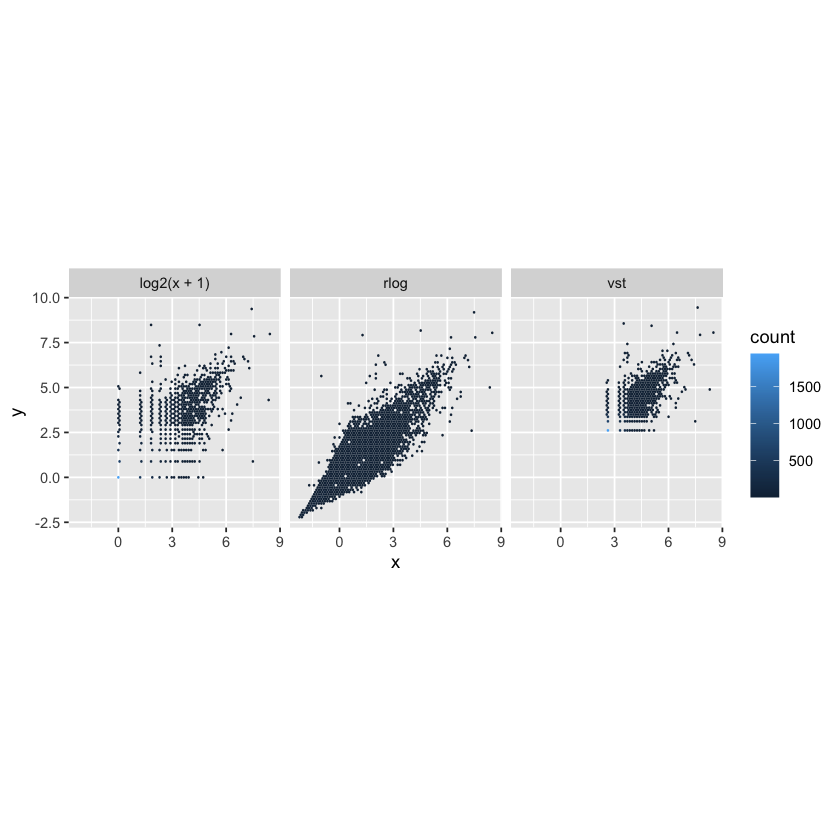

In [26]:
dds <- estimateSizeFactors(dds)

df <- bind_rows(
  as_data_frame(log2(counts(dds, normalized=TRUE)[, 1:2]+1)) %>%
         mutate(transformation = "log2(x + 1)"),
  as_data_frame(assay(vsd)[, 1:2]) %>% mutate(transformation = "vst"),
  as_data_frame(assay(rld)[, 1:2]) %>% mutate(transformation = "rlog"))
  
colnames(df)[1:2] <- c("x", "y")  

ggplot(df, aes(x = x, y = y)) + geom_hex(bins = 80) +
  coord_fixed() + facet_grid( . ~ transformation)  

* **Compute Euclidean sample distances**

> * Transpose dataset & coerce into matrix

In [27]:
sampleDists <- dist(t(assay(vsd)))
sampleDists

         S1_1_2_2 S1_1_2_3 S1_1_2_6 S1_2_2_1 S1_2_2_2 S1_2_2_4 S2_1_2_1
S1_1_2_3 62.37365                                                      
S1_1_2_6 60.87477 63.51211                                             
S1_2_2_1 65.14347 66.14350 67.09196                                    
S1_2_2_2 60.43657 62.17024 60.86169 62.21676                           
S1_2_2_4 54.90737 58.04675 55.33008 60.79352 54.96899                  
S2_1_2_1 61.06836 64.24817 62.92732 66.25061 61.34352 54.71495         
S2_1_2_4 60.24248 63.60022 61.43792 65.24283 60.86382 53.59792 54.50983
S2_1_2_5 58.23523 62.24722 60.22021 64.93263 59.25678 52.83179 52.82188
S2_2_2_2 54.79448 56.95623 55.71824 59.28227 54.57968 46.72088 49.61826
S2_2_2_5 59.97316 62.76278 61.51819 63.55434 59.31779 53.68229 52.94778
S2_2_2_9 58.63957 62.03843 59.91542 60.67397 57.01681 51.95634 53.19859
S3_1_2_2 69.36727 69.87528 69.25923 74.55958 70.12283 63.19659 69.31689
S3_1_2_4 66.28637 68.65964 67.20347 70.02654 66.40818 61.53353 6

* **Visualize sample distances with heatmap using Euclidean distances**

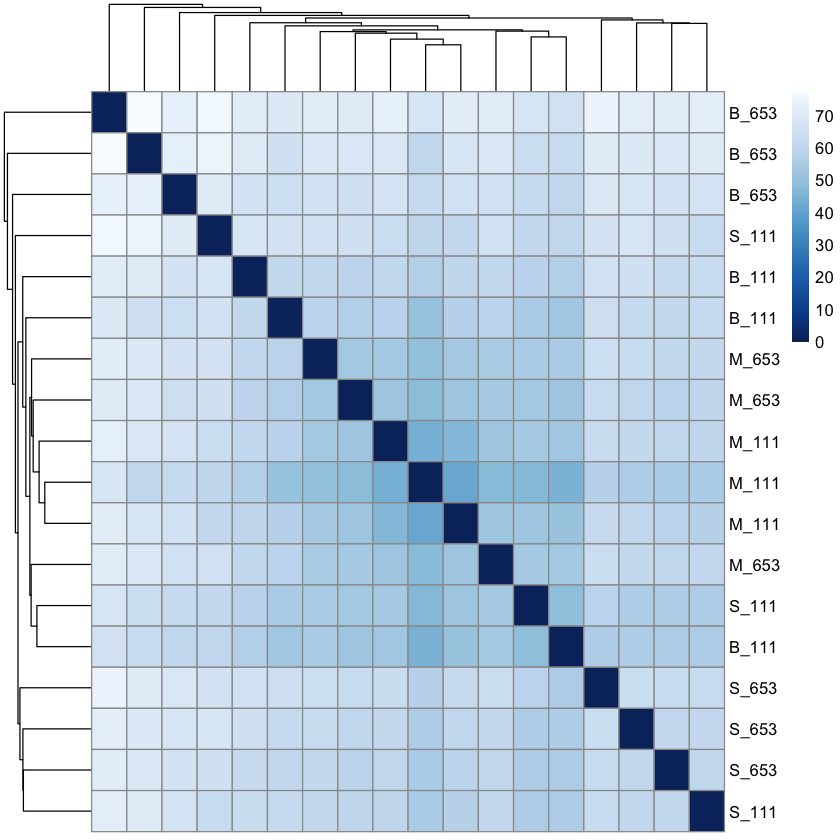

In [28]:
sampleDistMatrix <- as.matrix( sampleDists )
rownames(sampleDistMatrix) <- paste( vsd$group)
colnames(sampleDistMatrix) <- NULL
colors <- colorRampPalette(rev(brewer.pal(9, "Blues")))(255)
pheatmap(sampleDistMatrix,
         clustering_distance_rows = sampleDists,
         clustering_distance_cols = sampleDists,
         cluster_rows=T, cluster_cols=T,
         col = colors)

* **Compute Poisson distances (Witten 2011)**

> * Distances

In [29]:
poisd <- PoissonDistance(t(counts(dds)))

* **Visualize sample distances with heatmap using Poisson distances**

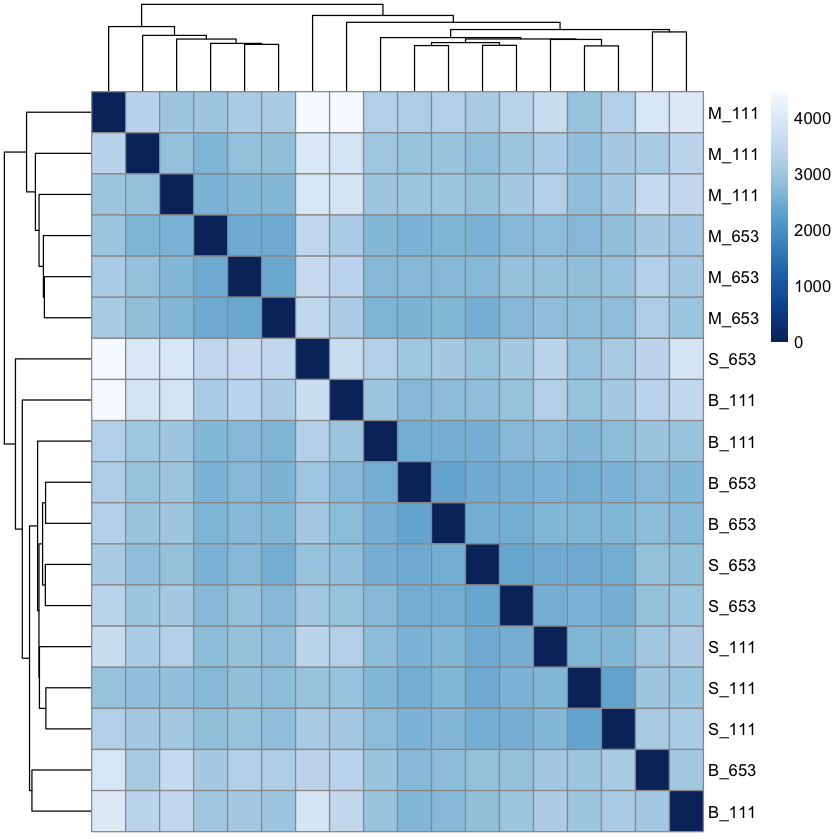

In [30]:
samplePoisDistMatrix <- as.matrix( poisd$dd )
rownames(samplePoisDistMatrix) <- paste( dds$group, sep=" - " )
colnames(samplePoisDistMatrix) <- NULL
pheatmap(samplePoisDistMatrix,
         clustering_distance_rows = poisd$dd,
         clustering_distance_cols = poisd$dd,
         col = colors)

* **Visualize sample-to-sample differences with pricipal components analysis (PCA)**

> * PCA with DESeq2

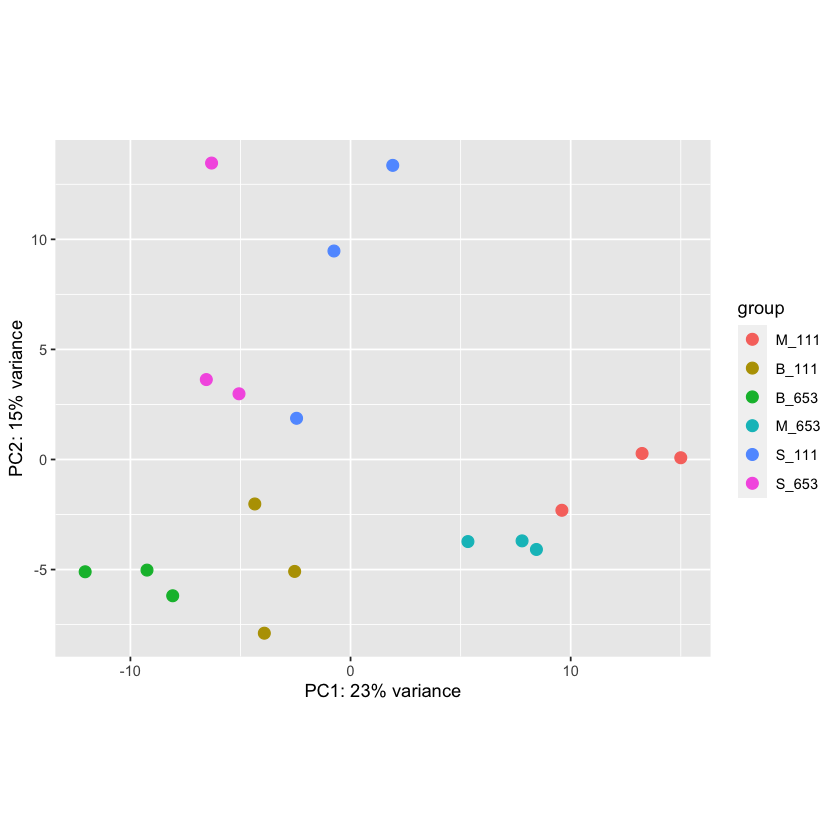

In [31]:
plotPCA(vsd, intgroup = c("group"))

> * PCA with ggplot2

> * View PCs

In [32]:
pcaData <- plotPCA(vsd, intgroup = c( "group"), returnData = TRUE)
pcaData

,PC1,PC2,group,group.1,name
,<dbl>,<dbl>,<fct>,<fct>,<fct>
S1_1_2_2,-5.0670810,2.98368084,S_653,S_653,S1_1_2_2
S1_1_2_3,-6.3131006,13.46481533,S_653,S_653,S1_1_2_3
S1_1_2_6,-6.5521485,3.63004041,S_653,S_653,S1_1_2_6
S1_2_2_1,1.9165738,13.36014915,S_111,S_111,S1_2_2_1
S1_2_2_2,-0.7539717,9.46999740,S_111,S_111,S1_2_2_2
S1_2_2_4,-2.4521969,1.87123416,S_111,S_111,S1_2_2_4
S2_1_2_1,7.7908504,-3.69671940,M_653,M_653,S2_1_2_1
S2_1_2_4,8.4426172,-4.08737874,M_653,M_653,S2_1_2_4
S2_1_2_5,5.3318858,-3.72825594,M_653,M_653,S2_1_2_5


> * Express variation explained to percentage

In [33]:
percentVar <- round(100 * attr(pcaData, "percentVar"))

> * Plot data

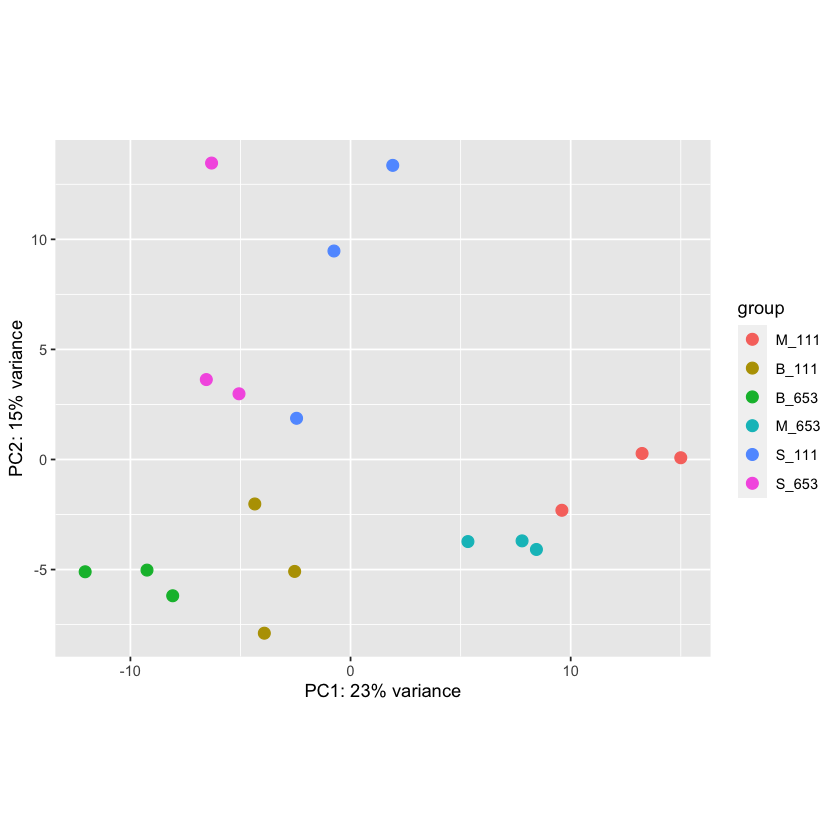

In [34]:
ggplot(pcaData, aes(x = PC1, y = PC2, color = group)) +
  geom_point(size =3) +
  xlab(paste0("PC1: ", percentVar[1], "% variance")) +
  ylab(paste0("PC2: ", percentVar[2], "% variance")) +
  coord_fixed()

* **Visualize sample-to-sample differences with multidimensional scaling (MDS)**

> * VSD data

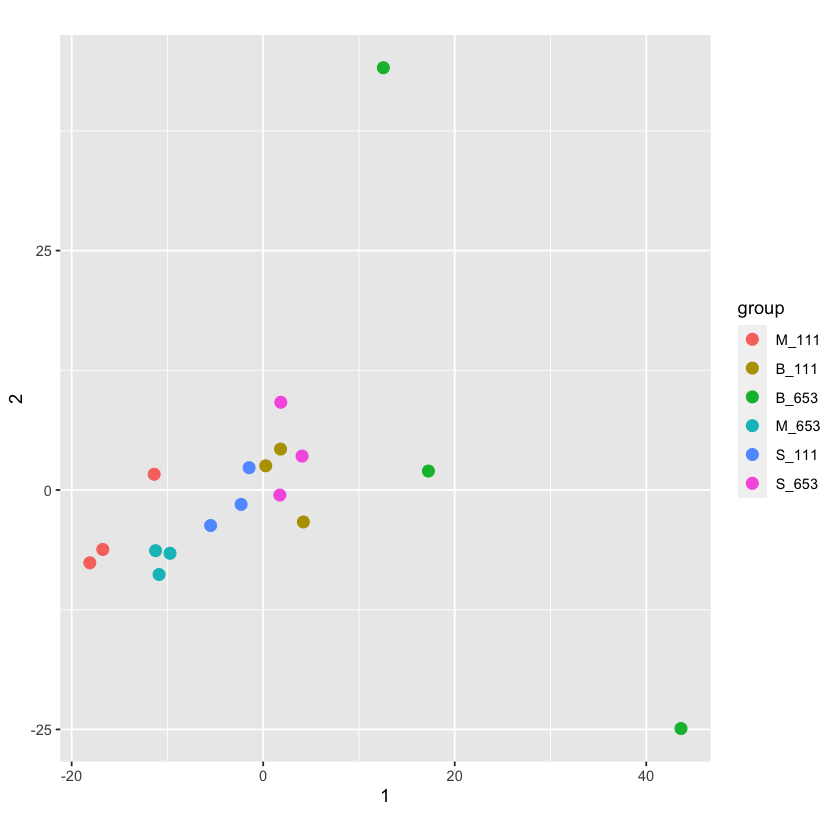

In [35]:
mds <- as.data.frame(colData(vsd))  %>%
         cbind(cmdscale(sampleDistMatrix))
ggplot(mds, aes(x = `1`, y = `2`, color = group)) +
  geom_point(size = 3) + coord_fixed()

> * Poisson data

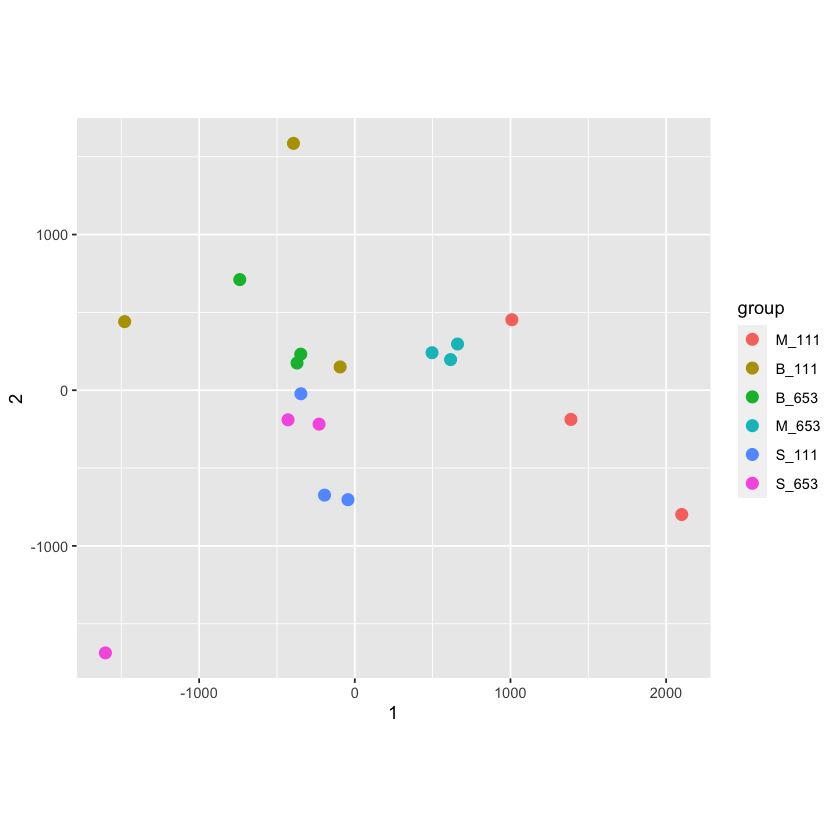

In [36]:
mdsPois <- as.data.frame(colData(dds)) %>%
   cbind(cmdscale(samplePoisDistMatrix))
ggplot(mdsPois, aes(x = `1`, y = `2`, color = group)) +
  geom_point(size = 3) + coord_fixed()

### Diagnostics<a class="anchor" id="nineth-q"></a>  
[Back to Table of Contents](#toc-q)

### Parametric analysis: differential expression analysis<a class="anchor" id="tenth-q"></a>  
[Back to Table of Contents](#toc-q)

* **Identify differentially expressed genes with raw count data**

In [37]:
dds <- DESeq(dds)

using pre-existing size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing



* **Tabulate results, set $\alpha = 0.05$**
* **Adjust $p$-values with Benjamini & Hochberg (1995) to account for false discoveries**
* **Shrink/deflate effect sizes (Log fold change estimates)**

**Comparisons between crops within isolates**

> Contrast M_653 ($Mentha\; x\; piperita$) vs S_653 ($Solanum\; tuberosum$)

In [38]:
M653vS653 = results(dds, contrast=c("group","M_653","S_653"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
M653vS653 = lfcShrink(dds, contrast=c("group","M_653","S_653"), res=M653vS653)

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [39]:
summary(M653vS653)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 13, 0.14%
LFC < 0 (down)     : 3, 0.032%
outliers [1]       : 4, 0.043%
low counts [2]     : 8673, 93%
(mean count < 11)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



> Contrast B_653 ($Brassica\; juncea$) vs S_653 ($Solanum\; tuberosum$)

In [40]:
B653vS653 = results(dds, contrast=c("group","B_653","S_653"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
B653vS653 = lfcShrink(dds, contrast=c("group","B_653","S_653"), res=B653vS653)

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [41]:
summary(B653vS653)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 2, 0.021%
LFC < 0 (down)     : 0, 0%
outliers [1]       : 4, 0.043%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



> Contrast S_111 ($Solanum\; tuberosum$) vs M_111 ($Mentha\; x\; piperita$)

In [42]:
S111vM111 = results(dds, contrast=c("group","S_111","M_111"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
S111vM111 = lfcShrink(dds, contrast=c("group","S_111","M_111"), res=S111vM111)

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [43]:
summary(S111vM111)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 3, 0.032%
LFC < 0 (down)     : 14, 0.15%
outliers [1]       : 4, 0.043%
low counts [2]     : 7950, 85%
(mean count < 6)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



> Contrast B_111 ($Brassica\; juncea$) vs M_111 ($Mentha\;x\;piperita$)

In [44]:
B111vM111 = results(dds, contrast=c("group","B_111","M_111"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
B111vM111 = lfcShrink(dds, contrast=c("group","B_111","M_111"), res=B111vM111 )

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [45]:
summary(B111vM111)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 6, 0.064%
LFC < 0 (down)     : 19, 0.2%
outliers [1]       : 4, 0.043%
low counts [2]     : 6325, 68%
(mean count < 3)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



**Comparisons between isolates within a host**

> Contrast S_111 ($Solanum\; tuberosum$) vs S_653 ($Solanum\; tuberosum$)

In [46]:
S111vS653 = results(dds, contrast=c("group","S_111","S_653"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
S111vS653 = lfcShrink(dds, contrast=c("group","S_111","S_653"), res=S111vS653)

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [47]:
summary(S111vS653)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 1, 0.011%
LFC < 0 (down)     : 0, 0%
outliers [1]       : 4, 0.043%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



> Contrast M_653 ($Mentha\;x\; piperita$) vs M_111 ($Mentha\;x\; piperita$)

In [48]:
M653vM111 = results(dds, contrast=c("group","M_653","M_111"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
M653vM111 = lfcShrink(dds, contrast=c("group","M_653","M_111"), res=M653vM111)

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [49]:
summary(M653vM111)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.011%
outliers [1]       : 4, 0.043%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



> Contrast B_653 ($Brassica\;juncea$) vs B_111 ($Brassica\;juncea$)

In [50]:
B111vB653 = results(dds, contrast=c("group","B_111","B_653"),
                independentFiltering=TRUE, alpha=0.001, pAdjustMethod="BH", parallel=TRUE)
B111vB653 = lfcShrink(dds, contrast=c("group","B_111","B_653"), res=B111vB653)

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



> Summary

In [51]:
summary(B111vB653)


out of 9322 with nonzero total read count
adjusted p-value < 0.001
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 0, 0%
outliers [1]       : 4, 0.043%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



* **Subset gene with > or < log 2 fold change and $q$ value < 0.05 ($p$ value post FDR adjustment)**

> * First define the cutoffs for log2 fold differences and the $q$ value 

In [52]:
log2cutoff = 2
qvaluecutoff = 0.001

> * Concatenate results that are differentially expressed (>log2) and adjusted p-values < $q = 0.001$

In [53]:
diffXGenes <- unique(c(
  rownames(subset(M653vS653, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)),
  rownames(subset(B653vS653, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)),

  rownames(subset(S111vM111, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)),
  rownames(subset(B111vM111, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)),

  rownames(subset(S111vS653, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)),
  rownames(subset(M653vM111, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)),
  rownames(subset(B111vB653, padj<=qvaluecutoff & (log2FoldChange)>=log2cutoff)))) 

* **Isolate genes for each comparison and sort by the log2 fold change estimates**

> Down-regulated genes

In [55]:
resSig_M6vS6 = subset(M653vS653, padj < 0.001) # M_653 vs S_653

In [56]:
head(resSig_M6vS6[ order(resSig_M6vS6$log2FoldChange), ]) # M_653 vs S_653

log2 fold change (MAP): group M_653 vs S_653 
Wald test p-value: group M_653 vs S_653 
DataFrame with 6 rows and 6 columns
                   baseMean    log2FoldChange             lfcSE
                  <numeric>         <numeric>         <numeric>
mRNA_1402  11.3439770738448 -2.84746242713012 0.578319866897879
mRNA_8402  16.5454716879924 -2.40839805906361 0.551458118642629
mRNA_7744  17.0690195084658 -2.06653806538914 0.457188601289264
mRNA_34      17.58778332936  1.98362448670049 0.458003842297231
mRNA_3627  18.2521513254457  2.38092633288543  0.53901025030457
mRNA_10037 21.5694899835185  2.47507190016391 0.451518697262107
                        stat               pvalue                 padj
                   <numeric>            <numeric>            <numeric>
mRNA_1402  -4.72305920551073  2.3232317946685e-06 0.000136225864323744
mRNA_8402   -4.2845125383293 1.83140280941447e-05 0.000834039434221179
mRNA_7744  -4.45417109078173 8.42179247361915e-06 0.000452671345457029
mRNA_34   

In [57]:
resSig_B6vS6 = subset(B653vS653, padj < 0.001) # B_653 vs S_653

In [58]:
head(resSig_B6vS6[ order(resSig_B6vS6$log2FoldChange), ]) # B_653 vs S_653

log2 fold change (MAP): group B_653 vs S_653 
Wald test p-value: group B_653 vs S_653 
DataFrame with 2 rows and 6 columns
                   baseMean   log2FoldChange             lfcSE             stat
                  <numeric>        <numeric>         <numeric>        <numeric>
mRNA_10347 67.6286668745138 3.79790632202771 0.417123175193003 8.85951100823774
mRNA_1341  40.6437530408797 5.17838373289777 0.648431609155538 6.79514329751121
                         pvalue                 padj
                      <numeric>            <numeric>
mRNA_10347 8.03661708937894e-19  7.4885198038833e-15
mRNA_1341  1.08204922028654e-11 5.04126731731497e-08

In [59]:
resSig_S1vM1 = subset(S111vM111, padj < 0.001)# S_111 vs M_111

In [60]:
head(resSig_S1vM1[ order(resSig_S1vM1$log2FoldChange), ])# S_111 vs M_111

log2 fold change (MAP): group S_111 vs M_111 
Wald test p-value: group S 111 vs M 111 
DataFrame with 6 rows and 6 columns
                   baseMean    log2FoldChange             lfcSE
                  <numeric>         <numeric>         <numeric>
mRNA_6472  35.4684547087944 -5.14096483193973 0.574942944708265
mRNA_10198   13.42287518775 -4.72867732753946 0.646201715045958
mRNA_183   7.97415585794323 -4.53462927390834 0.715544410591968
mRNA_8635  7.18972029497481 -4.06401419972423 0.723234153850694
mRNA_190   31.8935699284187 -3.73779709541171 0.451897354738498
mRNA_8909  39.0528761894467 -3.42022177808288 0.633377505571658
                        stat               pvalue                 padj
                   <numeric>            <numeric>            <numeric>
mRNA_6472  -7.55234781586716 4.27481017596244e-14 2.92397016035831e-11
mRNA_10198 -5.39254143300244 6.94680744737021e-08 1.58387209800041e-05
mRNA_183    -5.2638510045811 1.41068789289597e-07 2.75688719640241e-05
mRNA_8635 

In [61]:
resSig_B1vM1 = subset(B111vM111, padj < 0.001)# B_111 vs M_111

In [62]:
head(resSig_B1vM1[ order(resSig_B1vM1$log2FoldChange), ])# M_111 vs B_111

log2 fold change (MAP): group B_111 vs M_111 
Wald test p-value: group B 111 vs M 111 
DataFrame with 6 rows and 6 columns
                   baseMean    log2FoldChange             lfcSE
                  <numeric>         <numeric>         <numeric>
mRNA_8458  12.6870904921039 -5.82073417033232  0.63720199714839
mRNA_2785  7.74077965868209 -3.70302086339348 0.628891925281045
mRNA_10198   13.42287518775 -3.60503099970601  0.52156789475792
mRNA_299   19.8833001614866 -3.55020419002323 0.671543611314351
mRNA_2656  7.18452582769551 -3.53414517740578  0.61957898058379
mRNA_4837   8.5283577047331 -3.40028201839858  0.60370553520274
                        stat               pvalue                 padj
                   <numeric>            <numeric>            <numeric>
mRNA_8458  -6.48180099235637 9.06341383540345e-11 5.42535952187251e-08
mRNA_2785  -5.38197771011235 7.36718893375311e-08 2.00454513442937e-05
mRNA_10198 -6.48859431687349 8.66409118012921e-11 5.42535952187251e-08
mRNA_299  

In [63]:
resSig_S1vS6 = subset(S111vS653, padj < 0.001)# S_111 vs S_653

In [64]:
head(resSig_S1vS6[ order(resSig_S1vS6$log2FoldChange), ])# S_111 vs S_653

log2 fold change (MAP): group S_111 vs S_653 
Wald test p-value: group S_111 vs S_653 
DataFrame with 1 row and 6 columns
                  baseMean   log2FoldChange             lfcSE             stat
                 <numeric>        <numeric>         <numeric>        <numeric>
mRNA_8451 20.3253381935895 3.03648739118125 0.518420347885971 5.67733508790472
                        pvalue                 padj
                     <numeric>            <numeric>
mRNA_8451 1.36809313294067e-08 0.000127478918127411

In [65]:
resSig_M6vM1 = subset(M653vM111, padj < 0.05)# M_653 vs M_111

In [66]:
head(resSig_M6vM1[ order(resSig_M6vM1$log2FoldChange), ])# M_653 vs M_111

log2 fold change (MAP): group M_653 vs M_111 
Wald test p-value: group M 653 vs M 111 
DataFrame with 2 rows and 6 columns
                  baseMean    log2FoldChange             lfcSE
                 <numeric>         <numeric>         <numeric>
mRNA_8458 12.6870904921039 -3.23466867628227 0.482338694714703
mRNA_2428 98.0905702165762  -2.3093082713719 0.454185228560865
                       stat               pvalue                 padj
                  <numeric>            <numeric>            <numeric>
mRNA_8458 -6.36982582610703 1.89242984396082e-10 1.76336612860269e-06
mRNA_2428 -5.07171238533971 3.94251934623303e-07  0.00183681976340997

In [67]:
resSig_B1vB6 = subset(B111vB653, padj < 0.001)# B_111 vs B_653

In [68]:
head(resSig_B1vB6[ order(resSig_B1vB6$log2FoldChange), ])# B_111 vs B_653

log2 fold change (MAP): group B_111 vs B_653 
Wald test p-value: group B_111 vs B_653 
DataFrame with 0 rows and 6 columns

> Up-regulated genes

In [69]:
head(resSig_M6vS6[ order(resSig_M6vS6$log2FoldChange, decreasing = TRUE), ]) # M_653 vs S_653

log2 fold change (MAP): group M_653 vs S_653 
Wald test p-value: group M_653 vs S_653 
DataFrame with 6 rows and 6 columns
                   baseMean   log2FoldChange             lfcSE             stat
                  <numeric>        <numeric>         <numeric>        <numeric>
mRNA_190   31.8935699284187  5.1954449128997   0.6197381752921 5.87465016239449
mRNA_10198   13.42287518775 4.75378149708301 0.672799499565687 5.14115082684817
mRNA_6472  35.4684547087944 4.45966969958482 0.573118387053406 6.77379731447463
mRNA_8909  39.0528761894467 4.06155229981952 0.657685129833923 5.81531618656644
mRNA_621   114.211214989468 3.43658185820281 0.459845812982083 7.39428006241857
mRNA_7186  16.7326729600525 3.43612733580425 0.537730879303418 5.72720175231952
                         pvalue                 padj
                      <numeric>            <numeric>
mRNA_190   4.23737230472105e-09 9.11035045515025e-07
mRNA_10198   2.730607356773e-07 2.20155218139823e-05
mRNA_6472  1.254453866616

In [70]:
head(resSig_B6vS6[ order(resSig_B6vS6$log2FoldChange, decreasing = TRUE), ]) # B_653 vs S_653

log2 fold change (MAP): group B_653 vs S_653 
Wald test p-value: group B_653 vs S_653 
DataFrame with 2 rows and 6 columns
                   baseMean   log2FoldChange             lfcSE             stat
                  <numeric>        <numeric>         <numeric>        <numeric>
mRNA_1341  40.6437530408797 5.17838373289777 0.648431609155538 6.79514329751121
mRNA_10347 67.6286668745138 3.79790632202771 0.417123175193003 8.85951100823774
                         pvalue                 padj
                      <numeric>            <numeric>
mRNA_1341  1.08204922028654e-11 5.04126731731497e-08
mRNA_10347 8.03661708937894e-19  7.4885198038833e-15

In [71]:
head(resSig_S1vM1[ order(resSig_S1vM1$log2FoldChange, decreasing = TRUE), ])# S_111 vs M_111

log2 fold change (MAP): group S_111 vs M_111 
Wald test p-value: group S 111 vs M 111 
DataFrame with 6 rows and 6 columns
                  baseMean    log2FoldChange             lfcSE
                 <numeric>         <numeric>         <numeric>
mRNA_9290 14.5961172209997  2.42884462016895 0.464041103107312
mRNA_1922 14.3061649022669  2.06713303859854 0.470542841794555
mRNA_1128 19.8123335873755  1.80315619553434 0.410176049688239
mRNA_34     17.58778332936  -2.0015715200374 0.440343874548317
mRNA_8565  9.7469010684972 -2.77266154688919 0.538720851730543
mRNA_621  114.211214989468  -3.0286024427962 0.441480709553704
                       stat               pvalue                 padj
                  <numeric>            <numeric>            <numeric>
mRNA_9290  5.20021918483714 1.99053648686401e-07 3.02561546003329e-05
mRNA_1922  4.38129095840669 1.17978200136462e-05 0.000949377516392235
mRNA_1128  4.39470532416523 1.10923117898911e-05 0.000948392658035692
mRNA_34   -4.4448400886

In [72]:
head(resSig_B1vM1[ order(resSig_B1vM1$log2FoldChange, decreasing = TRUE), ])# B_111 vs M_111

log2 fold change (MAP): group B_111 vs M_111 
Wald test p-value: group B 111 vs M 111 
DataFrame with 6 rows and 6 columns
                   baseMean   log2FoldChange             lfcSE             stat
                  <numeric>        <numeric>         <numeric>        <numeric>
mRNA_1342  12.6957408508625 5.48741673877337 0.779873797858444 6.07251816110537
mRNA_1341  40.6437530408797 5.44245671271535 0.589021317775898 8.62755014246224
mRNA_3553  7.50712963913642 3.40701398240061 0.561867942970402 5.77199386608778
mRNA_9681  7.74964452451805  3.1940267821895  0.58516244271444 5.22608452672578
mRNA_10347 67.6286668745138 2.58582131119405 0.342548287758333 7.52897180566978
mRNA_8071  11.5743568973005 2.26114410168938 0.500430748896329  4.4683432487414
                         pvalue                 padj
                      <numeric>            <numeric>
mRNA_1342  1.25919852518002e-09 6.28130197643966e-07
mRNA_1341   6.2680059523328e-18 1.87601418153321e-14
mRNA_3553  7.833896866473

In [73]:
head(resSig_S1vS6[ order(resSig_S1vS6$log2FoldChange,decreasing = TRUE), ])# S_111 vs S_653

log2 fold change (MAP): group S_111 vs S_653 
Wald test p-value: group S_111 vs S_653 
DataFrame with 1 row and 6 columns
                  baseMean   log2FoldChange             lfcSE             stat
                 <numeric>        <numeric>         <numeric>        <numeric>
mRNA_8451 20.3253381935895 3.03648739118125 0.518420347885971 5.67733508790472
                        pvalue                 padj
                     <numeric>            <numeric>
mRNA_8451 1.36809313294067e-08 0.000127478918127411

In [74]:
head(resSig_M6vM1[ order(resSig_M6vM1$log2FoldChange,decreasing = TRUE), ])# M_653 vs M_111

log2 fold change (MAP): group M_653 vs M_111 
Wald test p-value: group M 653 vs M 111 
DataFrame with 2 rows and 6 columns
                  baseMean    log2FoldChange             lfcSE
                 <numeric>         <numeric>         <numeric>
mRNA_2428 98.0905702165762  -2.3093082713719 0.454185228560865
mRNA_8458 12.6870904921039 -3.23466867628227 0.482338694714703
                       stat               pvalue                 padj
                  <numeric>            <numeric>            <numeric>
mRNA_2428 -5.07171238533971 3.94251934623303e-07  0.00183681976340997
mRNA_8458 -6.36982582610703 1.89242984396082e-10 1.76336612860269e-06

In [75]:
head(resSig_B1vB6[ order(resSig_B1vB6$log2FoldChange,decreasing = TRUE), ])# B_111 vs B_653

log2 fold change (MAP): group B_111 vs B_653 
Wald test p-value: group B_111 vs B_653 
DataFrame with 0 rows and 6 columns

**Build Table of DEGs**

Bind all DEGs from each comparisons, by rows

In [76]:
DEGs=rbind(c(resSig_M6vS6@rownames,
             resSig_B6vS6@rownames,
             
             resSig_S1vM1@rownames,
             resSig_B1vM1@rownames,
             
             resSig_S1vS6@rownames,
             resSig_M6vM1@rownames,
             resSig_B1vB6@rownames))

IDs

In [77]:
ID=rep(c("M6vS6", "B6vS6",
         "S1vM1", "B1vM1",
         "S1vS6", "M6vM1", "B1vB6"),
               c(length(resSig_M6vS6@rownames),
                 length(resSig_B6vS6@rownames),
                 
                 length(resSig_S1vM1@rownames),
                 length(resSig_B1vM1@rownames),
                
                 length(resSig_S1vS6@rownames),
                 length(resSig_M6vM1@rownames),
                 length(resSig_B1vB6@rownames)))

Bind DEGs and IDs by column

In [78]:
DEGS=data.frame(as.character(DEGs),ID)

Rename columns

In [79]:
colnames(DEGS) = c("Gene_ID","Comparison") 

Sanity Checks

In [80]:
length(DEGS$Gene_ID)==length(ID)

[1] TRUE

In [81]:
length(resSig_M6vS6@rownames)

[1] 16

In [82]:
length(resSig_B6vS6@rownames)

[1] 2

In [83]:
length(resSig_S1vM1@rownames)

[1] 17

In [84]:
length(resSig_B1vM1@rownames)

[1] 25

In [85]:
length(resSig_S1vS6@rownames)

[1] 1

In [86]:
length(resSig_M6vM1@rownames)

[1] 2

In [87]:
length(resSig_B1vB6@rownames)

[1] 0

In [88]:
length(DEGS$Gene_ID) == length(resSig_M6vS6@rownames)+length(resSig_B6vS6@rownames)+
length(resSig_S1vM1@rownames)+length(resSig_B1vM1@rownames)+length(resSig_S1vS6@rownames)+
length(resSig_M6vM1@rownames)+length(resSig_B1vB6@rownames)

[1] TRUE

Write data into table

In [89]:
setwd('/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/DATA/R_FILES/DEGs/')

In [408]:
write.csv(DEGS, 
          file="Fungal_DEGs.csv")

**Merge Gene Names with DEGs**

Create column with rownames

In [104]:
M653vS653$id <- rownames(M653vS653)
B653vS653$id <- rownames(B653vS653)

S111vM111$id <- rownames(S111vM111)
B111vM111$id <- rownames(B111vM111)

S111vS653$id <- rownames(S111vS653)
M653vM111$id <- rownames(M653vM111)
B111vB653$id <- rownames(B111vB653)

Merge data tables

In [105]:
M653vS653_GeneNames <- merge(as(M653vS653,"data.frame"), gnDF, by="id")
B653vS653_GeneNames <- merge(as(B653vS653,"data.frame"), gnDF, by="id")

S111vM111_GeneNames <- merge(as(S111vM111,"data.frame"), gnDF, by="id")
B111vM111_GeneNames <- merge(as(B111vM111,"data.frame"), gnDF, by="id")

S111vS653_GeneNames <- merge(as(S111vS653,"data.frame"), gnDF, by="id")
M653vM111_GeneNames <- merge(as(M653vM111,"data.frame"), gnDF, by="id")
B111vB653_GeneNames <- merge(as(B111vB653,"data.frame"), gnDF, by="id")


Check for unique genes between two datasets - run after Merge Gene Names with DEGs

In [90]:
diffXGenes[!(diffXGenes %in% DEGS$Gene_ID)]

character(0)

### Visualization<a class="anchor" id="eleventh-q"></a>  
[Back to Table of Contents](#toc-q)

**MA plot**

In [137]:
setwd("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/")

* S_653 ($Solanum\; tuberosum$) vs M_653 ($Mentha\;x\;piperita$)

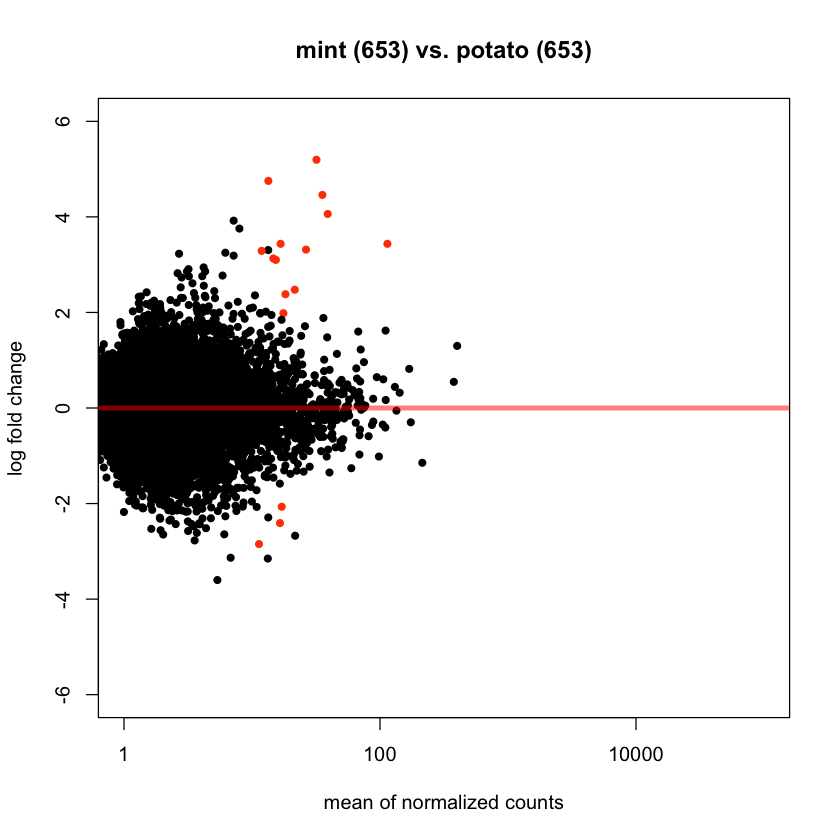

In [92]:
#tiff("Mint_653_vs_Potato_653_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(M653vS653, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="mint (653) vs. potato (653)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

* S_653 ($Solanum\; tuberosum$) vs B_653 ($Brassica\; juncea$)

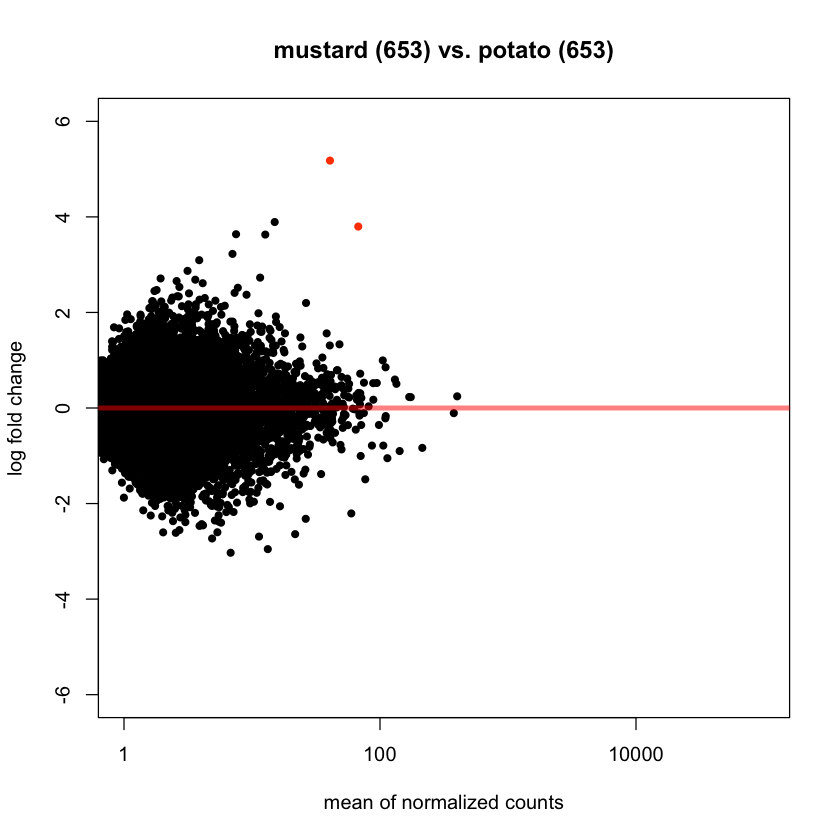

In [93]:
#tiff("Mustard_653_vs_Potato_653_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(B653vS653, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="mustard (653) vs. potato (653)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

* S_111 ($Solanum\; tuberosum$) vs M_111 ($Mentha\;x\;piperita$)

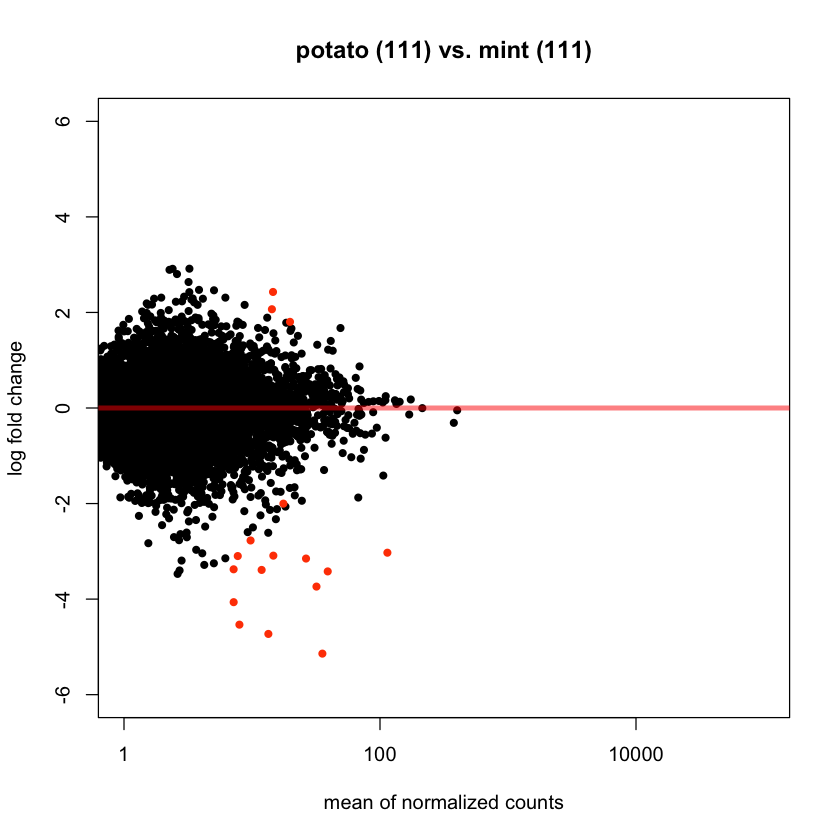

In [94]:
#tiff("Potato_111_vs_Mint_111_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(S111vM111, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="potato (111) vs. mint (111)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

* M_111 ($Mentha\;x\;piperita$) vs B_111 ($Brassica\; juncea$)

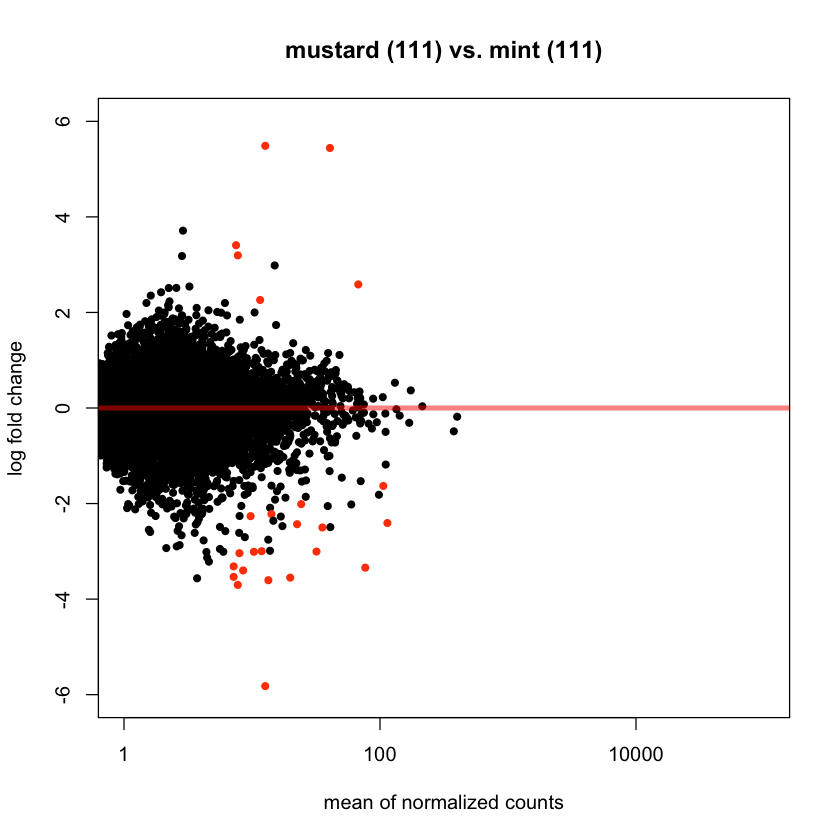

In [95]:
#tiff("Mustard_111_vs_Mint_111_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(B111vM111, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="mustard (111) vs. mint (111)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

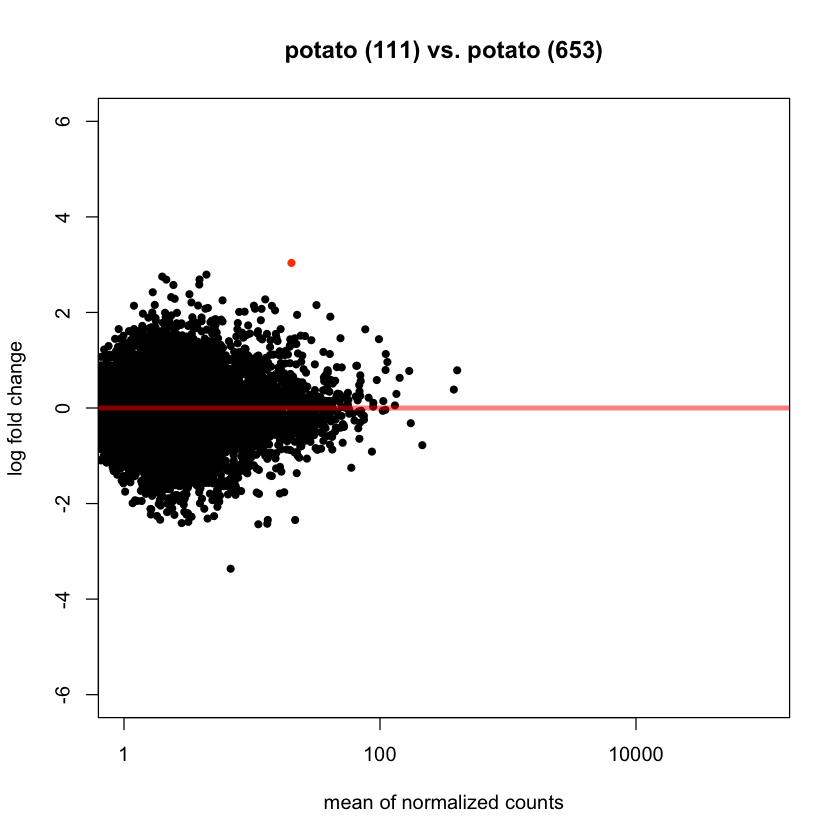

In [96]:
#tiff("Potato_111_vs_Potato_653_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(S111vS653, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="potato (111) vs. potato (653)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

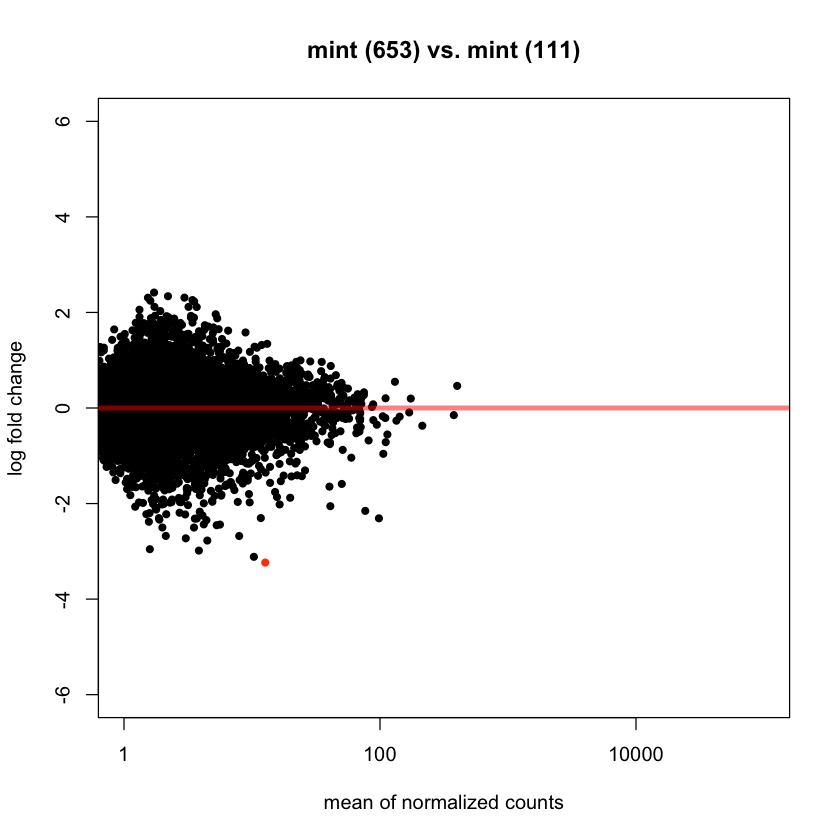

In [97]:
#tiff("Mint_653_vs_Mint_111_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(M653vM111, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="mint (653) vs. mint (111)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

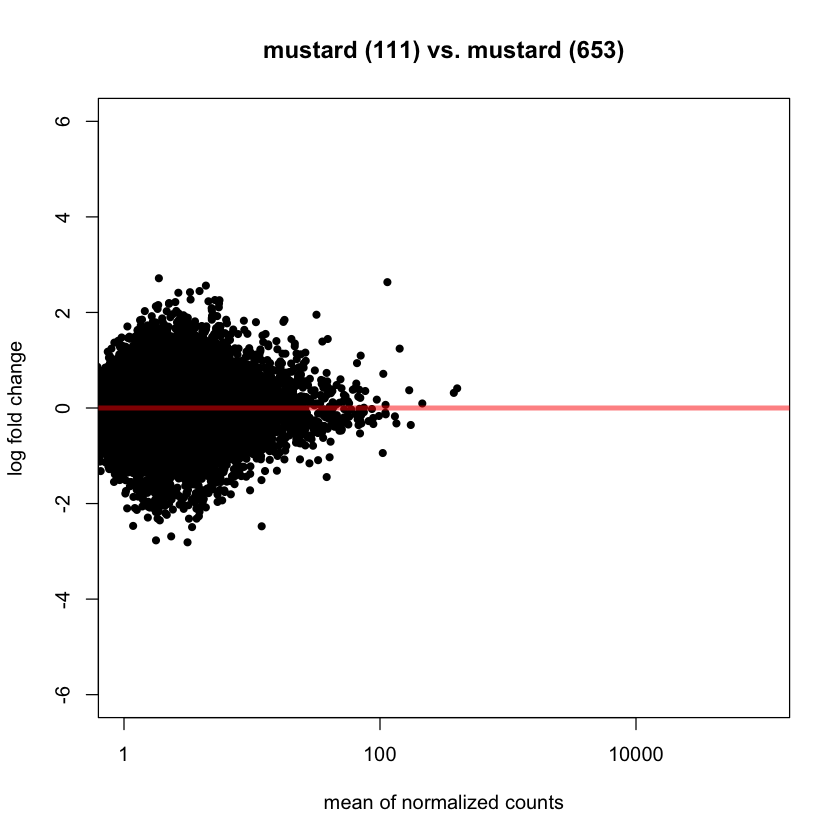

In [98]:
#tiff("Mustard_111_vs_Mustard_653_MA-P.tiff", width=5, height=5, units='in', res=300)
xlim <- c(1,1e5); ylim <- c(-6,6)
DESeq2::plotMA(B111vB653, 
                  xlim=xlim, ylim=ylim,
                  cex=0.9, alpha = 0.001,
                  main="mustard (111) vs. mustard (653)",
                  colNonSig="black",colSig="orangered1")
#dev.off()

**Histograms of $p$-values**

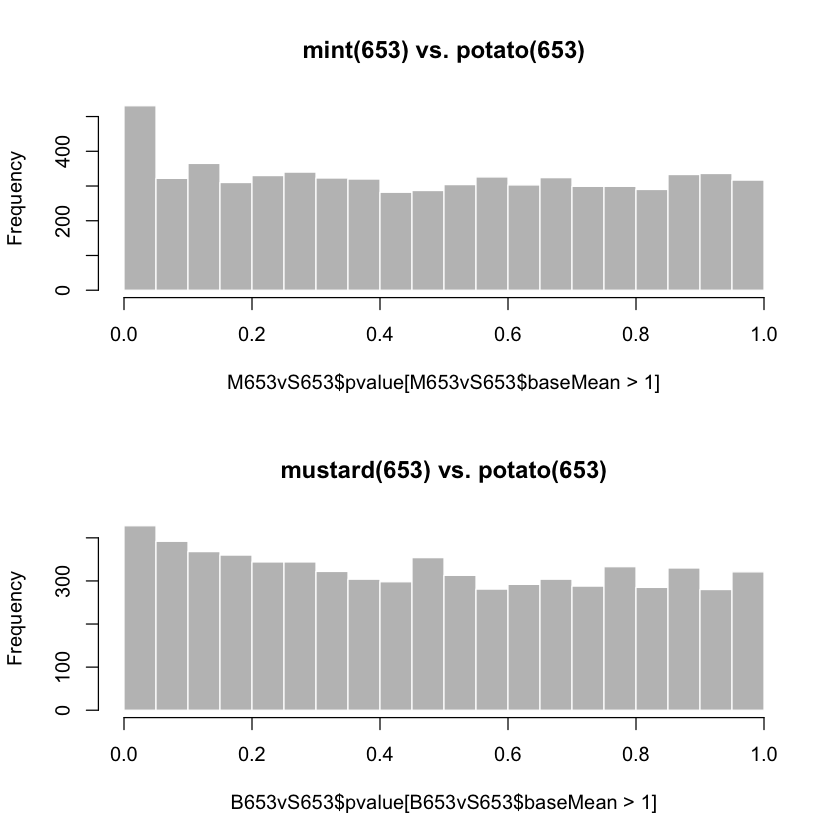

In [99]:
par(mfrow=c(2,1))
hist(M653vS653$pvalue[M653vS653$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "mint(653) vs. potato(653)")
hist(B653vS653$pvalue[B653vS653$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "mustard(653) vs. potato(653)")

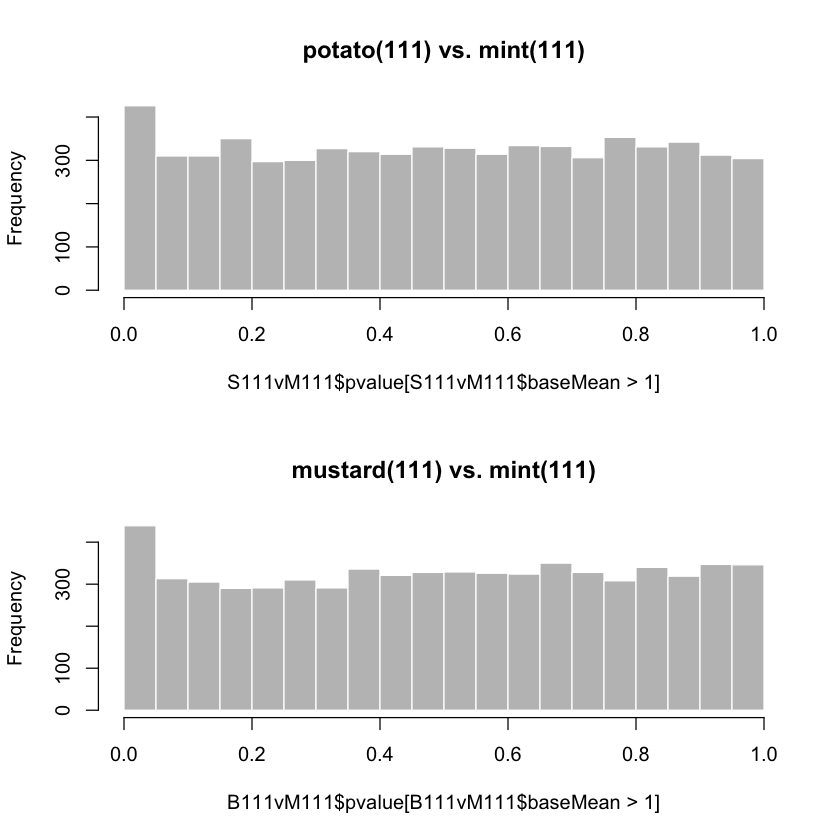

In [100]:
par(mfrow=c(2,1))
hist(S111vM111$pvalue[S111vM111$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "potato(111) vs. mint(111)")
hist(B111vM111$pvalue[B111vM111$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "mustard(111) vs. mint(111)")

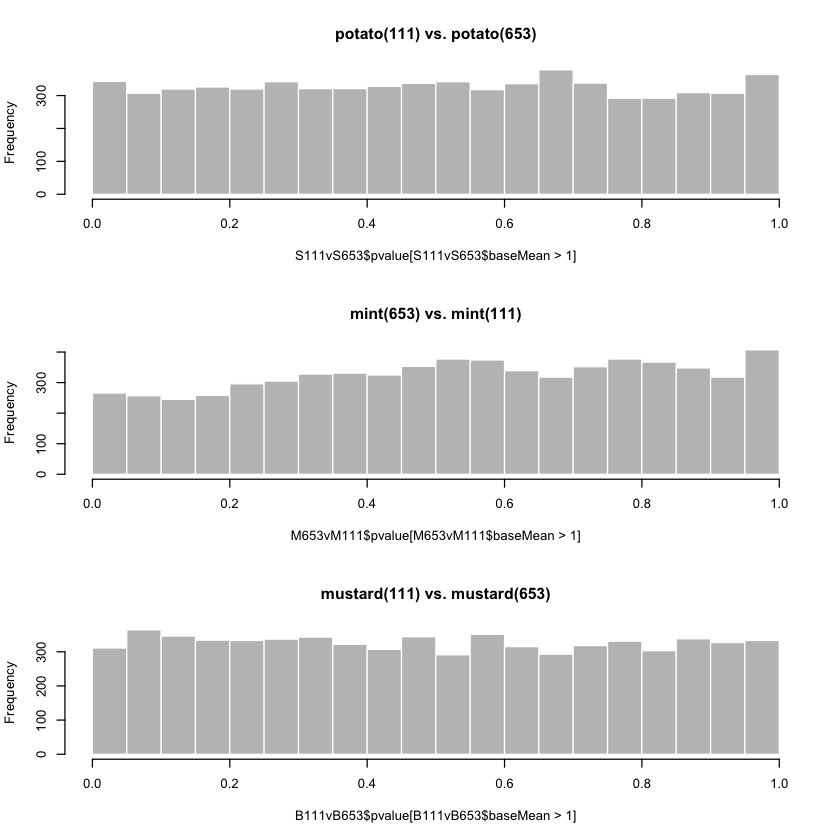

In [101]:
par(mfrow=c(3,1))
hist(S111vS653$pvalue[S111vS653$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "potato(111) vs. potato(653)")
hist(M653vM111$pvalue[M653vM111$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "mint(653) vs. mint(111)")
hist(B111vB653$pvalue[B111vB653$baseMean > 1], breaks = 0:20/20,
     col = "grey75", border = "white", main = "mustard(111) vs. mustard(653)")

**Volcano plots**

* M_653 ($Mentha\;x\;piperita$) vs S_653 ($Solanum\; tuberosum$)

Warning message in EnhancedVolcano(M653vS653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(M653vS653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



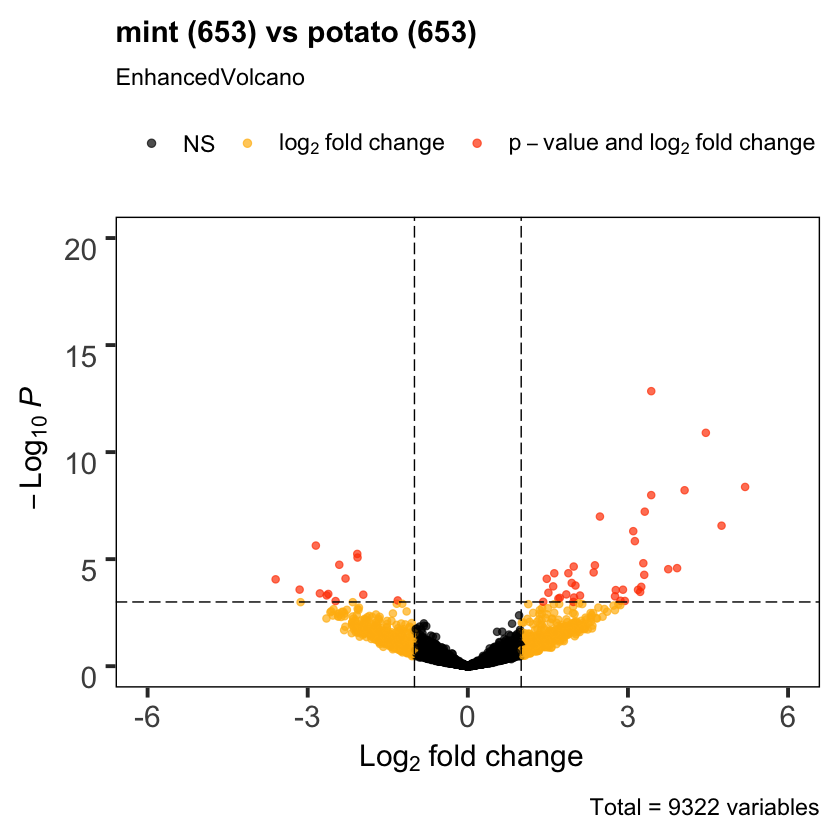

In [91]:
#tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Mint-653_vs_Potato-653_VP.tiff",
 #   width=10, height=10, units='in', res=300)

MvS=EnhancedVolcano(M653vS653,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "mint (653) vs potato (653)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

MvS + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

#dev.off()

* B_653 ($Brassica\;juncea$) vs S_653 ($Solanum\; tuberosum$) 

Warning message in EnhancedVolcano(B653vS653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(B653vS653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



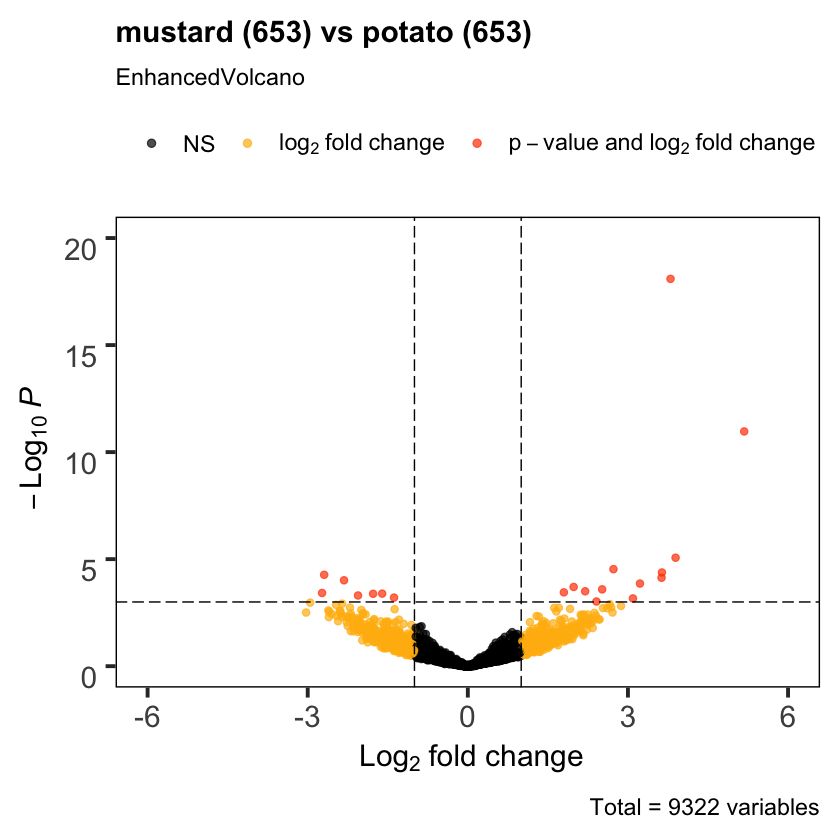

In [92]:
#tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Mustard-653_vs_Potato-653_VP.tiff",
    # width=10, height=10, units='in', res=300)

BvS=EnhancedVolcano(B653vS653,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "mustard (653) vs potato (653)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

BvS + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

#dev.off()

* S_111 ($Solanum\; tuberosum$) vs M_111 ($Mentha\;x\;piperita$)

Warning message in EnhancedVolcano(S111vM111, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(S111vM111, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



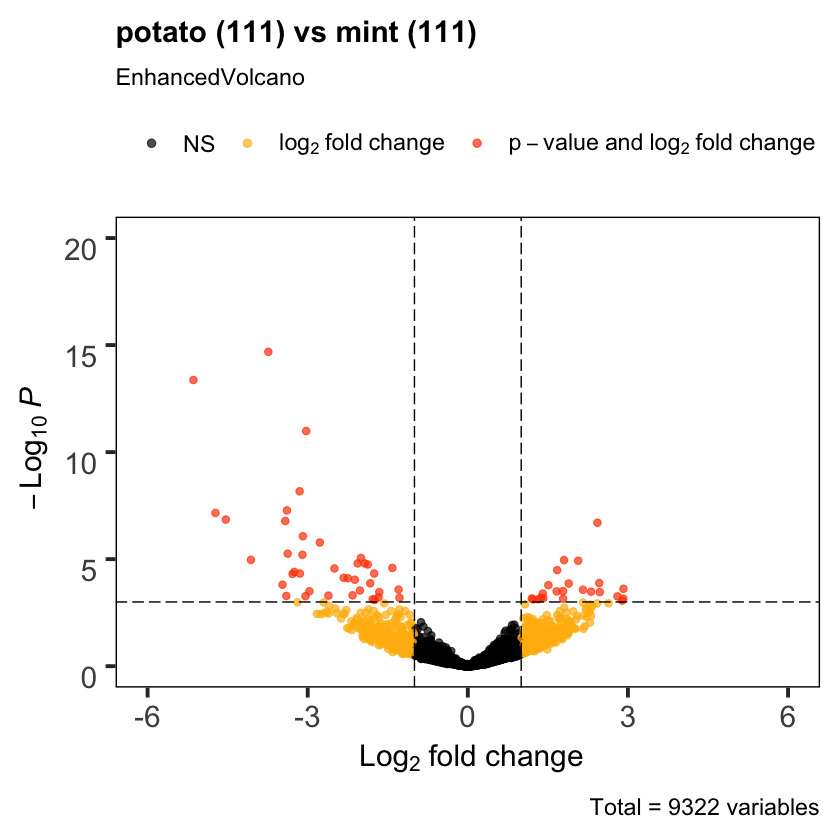

In [93]:
#tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Potato-111_vs_Mint-111_VP.tiff",
#     width=10, height=10, units='in', res=300)

SvM=EnhancedVolcano(S111vM111,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "potato (111) vs mint (111)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

SvM + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

#dev.off()

* B_111 ($Brassica\;juncea$) vs M_111 ($Mint\;x\;piperita$)

Warning message in EnhancedVolcano(B111vM111, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(B111vM111, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



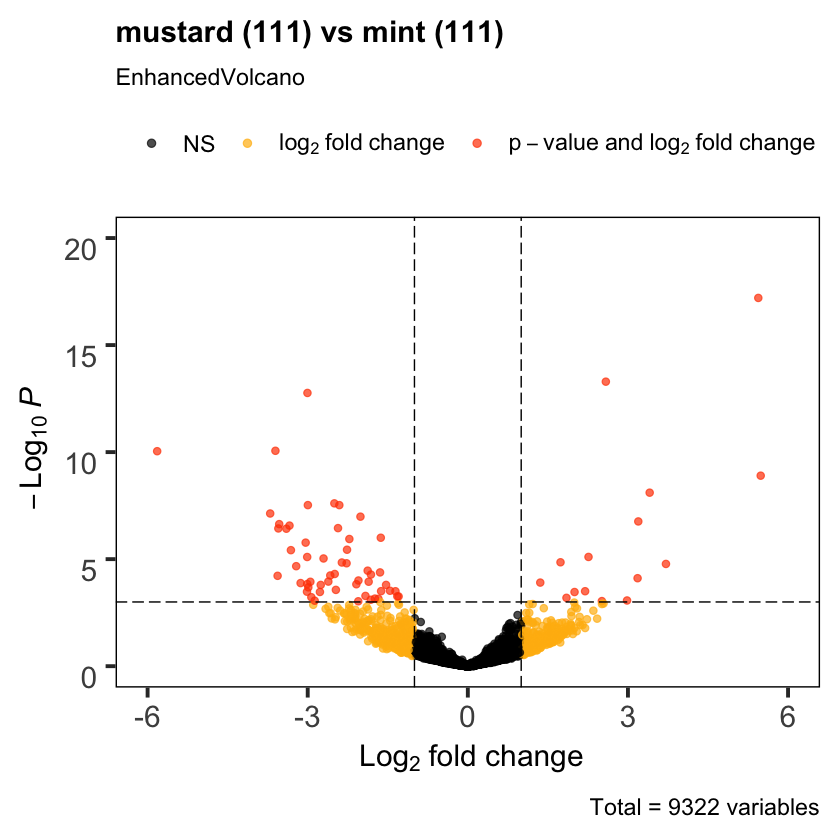

In [94]:
# tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Mustard-111_vs_Mint-111_VP.tiff",
#      width=10, height=10, units='in', res=300)

BvM=EnhancedVolcano(B111vM111,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "mustard (111) vs mint (111)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

BvM + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

# dev.off()

* S_653 ($Solanum\;tuberosum$) vs S_111 ($Solanum\;tuberosum$)

Warning message in EnhancedVolcano(S111vS653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(S111vS653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



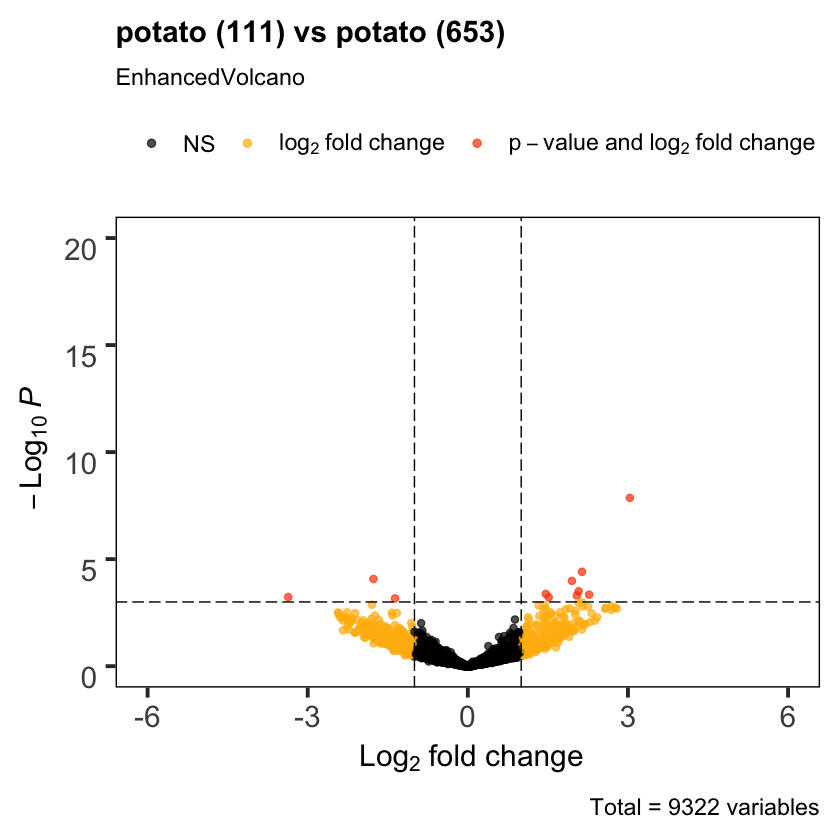

In [95]:
# tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Potato-111_vs_Potato-653_VP.tiff",
#      width=10, height=10, units='in', res=300)

SvS=EnhancedVolcano(S111vS653,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "potato (111) vs potato (653)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

SvS + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

# dev.off()

* M_653 ($Mint\;x\;piperita$) vs M_111 ($Mint\;x\;piperita$) 

Warning message in EnhancedVolcano(M653vM111, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(M653vM111, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



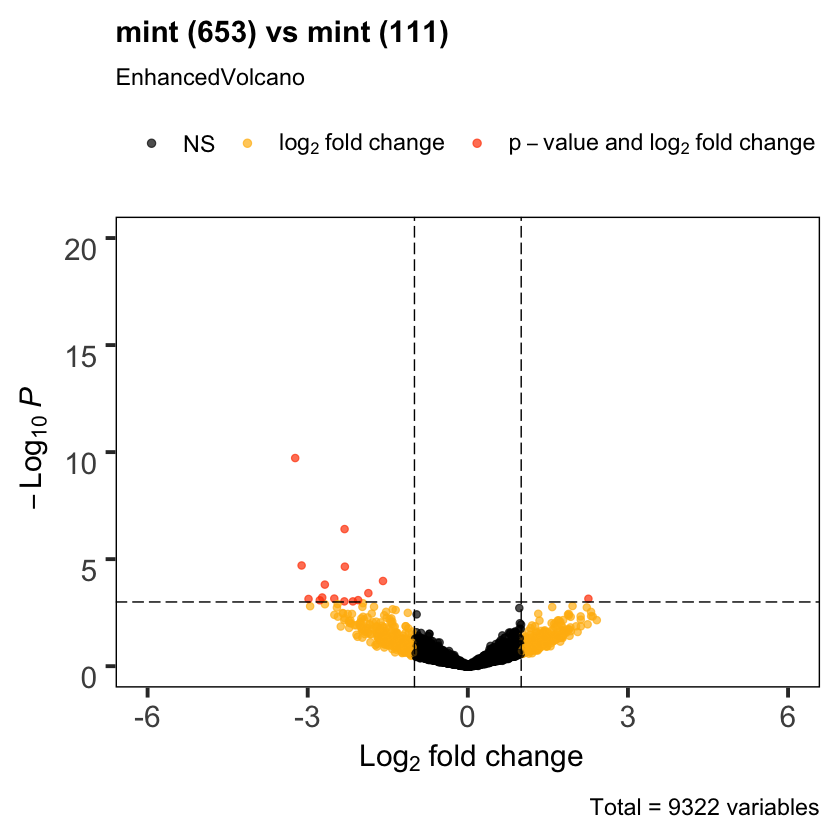

In [97]:
# tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Mint-653_vs_Mint-111_VP.tiff",
#      width=10, height=10, units='in', res=300)

MvM=EnhancedVolcano(M653vM111,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "mint (653) vs mint (111)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

MvM + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

# dev.off()

* B_111 ($Brassica\;juncea$) vs B_653 ($Brassica\;juncea$)

Warning message in EnhancedVolcano(B111vB653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptPointSize argument deprecated in v1.4 - please use pointSize”
Warning message in EnhancedVolcano(B111vB653, lab = NA, x = "log2FoldChange", y = "pvalue", :
“transcriptLabSize argument deprecated in v1.4 - please use labSize”
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



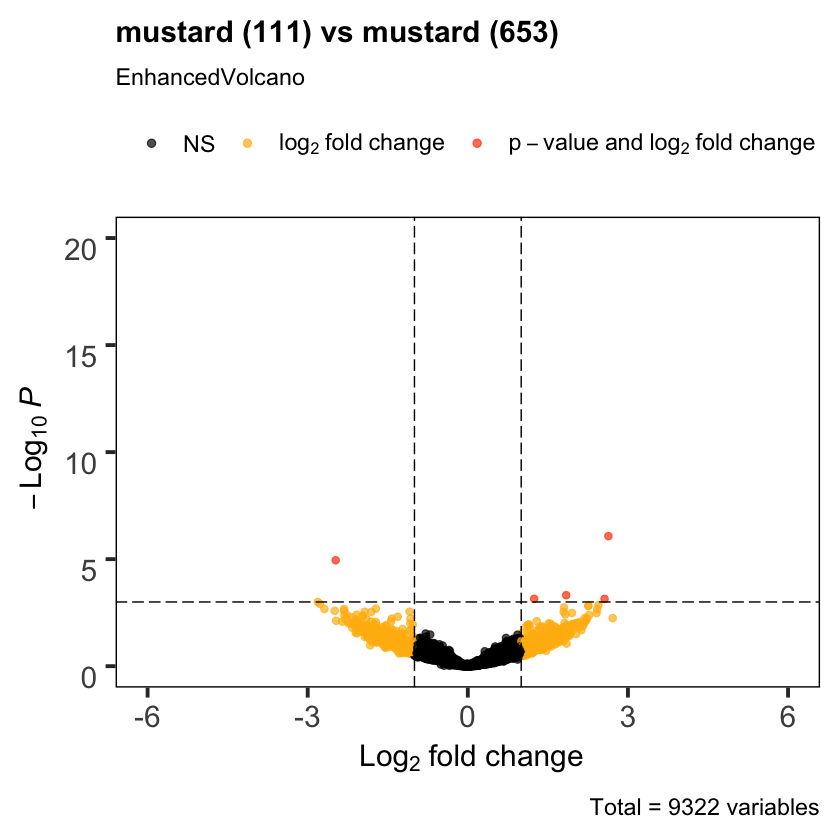

In [98]:
# tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Mustard-111_vs_Mustard-653_VP.tiff",
#      width=10, height=10, units='in', res=300)

BvB=EnhancedVolcano(B111vB653,
    lab = NA,
    x = 'log2FoldChange',
    y = 'pvalue',
    title = "mustard (111) vs mustard (653)",
    legend=c("NS","Log2 fold-change","p-value",
    "p-value & Log2 fold-change"),
    legendPosition = "top",
    legendLabSize = 14,
    legendIconSize = 2.0,
    pCutoff = 0.001,
    FCcutoff = 1.0,
    transcriptPointSize = 1.75,
    transcriptLabSize = 3.0,
    colAlpha = 0.7,
    border = "full",
    gridlines.major = FALSE,
    gridlines.minor = FALSE,          
    xlim = c(-6, 6),
    ylim = c(0, 20),
    col=c("black", "darkgoldenrod1", "gray38", "orangered1"))

BvB + scale_color_manual(
  values=c(
    NS="black",
    FC="darkgoldenrod1",
    P="gray38",
    FC_P="orangered1"),
  labels=c(
    NS='NS',
    FC=expression(log[2]~fold~change),
    P="p-value",
    FC_P=expression(p-value~and~log[2]~fold~change)))

# dev.off()

Where are the biggest changes?

In [111]:
max(abs(M653vS653_GeneNames$log2FoldChange))
max(abs(B653vS653_GeneNames$log2FoldChange))

max(abs(S111vM111_GeneNames$log2FoldChange))
max(abs(B111vM111_GeneNames$log2FoldChange))

max(abs(S111vS653_GeneNames$log2FoldChange))
max(abs(M653vM111_GeneNames$log2FoldChange))
max(abs(B111vB653_GeneNames$log2FoldChange))

[1] 5.195445

[1] 5.178384

[1] 5.140965

[1] 5.820734

[1] 3.036487

[1] 3.234669

[1] 2.633991

**Cluster Genes**

Heatmap I

Are there any duplicate genes?

In [225]:
table_all[,7][duplicated(table_all[,7])]

[1] "mRNA_190"   "mRNA_10198" "mRNA_6472"  "mRNA_1341"  "mRNA_10347"
[6] "mRNA_10198" "mRNA_8458"

Number of unique genes

In [226]:
length(unique(table_all[,7]))

[1] 23

Remove duplicate genes

In [227]:
degs = table_all[!duplicated(table_all[,7]),]

Object for heatmap

In [228]:
heat <- assay(vsd)[degs[,7],]

Convert to dataframe

In [229]:
hmDF = data.frame(heat)

Confirm Order

In [230]:
rownames(hmDF) == degs[,7]

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[16] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Find indices of unknown genes

In [231]:
rownames(hmDF)[which(degs[,6] == "-")]

[1] "mRNA_6472" "mRNA_7744" "mRNA_1341" "mRNA_9290" "mRNA_1128" "mRNA_1342"
[7] "mRNA_299"  "mRNA_8458"

Replace dashes with mRNA names

- Index objects

In [233]:
Index = degs[,6] == "-"

- convert to character to solve NA problem

In [234]:
degs[,6] = as.character(degs[,6])

* replace NAs with fragment names

In [235]:
degs[,6][Index] = rownames(hmDF)[Index]

Replace rownames in heatmap object with gene names

In [240]:
length(unique(degs[,6])) == length(degs[,6])

[1] TRUE

In [241]:
rownames(hmDF) = degs[,6]

In [242]:
rownames(hmDF)

[1] "TERA_ASPTN" "AYG1_ASPFU" "mRNA_6472"  "THR1_COLOR" "YL54_SCHPO"
 [6] "mRNA_7744"  "MEP3_YEAST" "GLNA_NEUCR" "mRNA_1341"  "YDDQ_BACSU"
[11] "mRNA_9290"  "RCF2_SCHPO" "mRNA_1128"  "SCYD_COLOR" "ARP2_ASPFU"
[16] "mRNA_1342"  "BFR1_SCHPO" "DUS4_SCHPO" "YUC7_ARATH" "mRNA_299"  
[21] "PLYF_ASPFC" "mRNA_8458"  "AOX_PODAS"

Reorder genes

In [247]:
ord_row_labs = rownames(hmDF)[(Fungi_DEGs$tree_row$order)]

In [248]:
row_labs = cat(paste0('"', paste(ord_row_labs, collapse="\", \""), '"'))

"YDDQ_BACSU", "mRNA_1341", "mRNA_1342", "BFR1_SCHPO", "DUS4_SCHPO", "YL54_SCHPO", "mRNA_6472", "TERA_ASPTN", "THR1_COLOR", "SCYD_COLOR", "YUC7_ARATH", "AYG1_ASPFU", "ARP2_ASPFU", "PLYF_ASPFC", "mRNA_8458", "mRNA_299", "RCF2_SCHPO", "AOX_PODAS", "MEP3_YEAST", "GLNA_NEUCR", "mRNA_1128", "mRNA_7744", "mRNA_9290"

Italicize names

In [249]:
newnames <- lapply(
  rownames(hmDF),
  function(x) bquote(italic(.(x))))

Heatmap

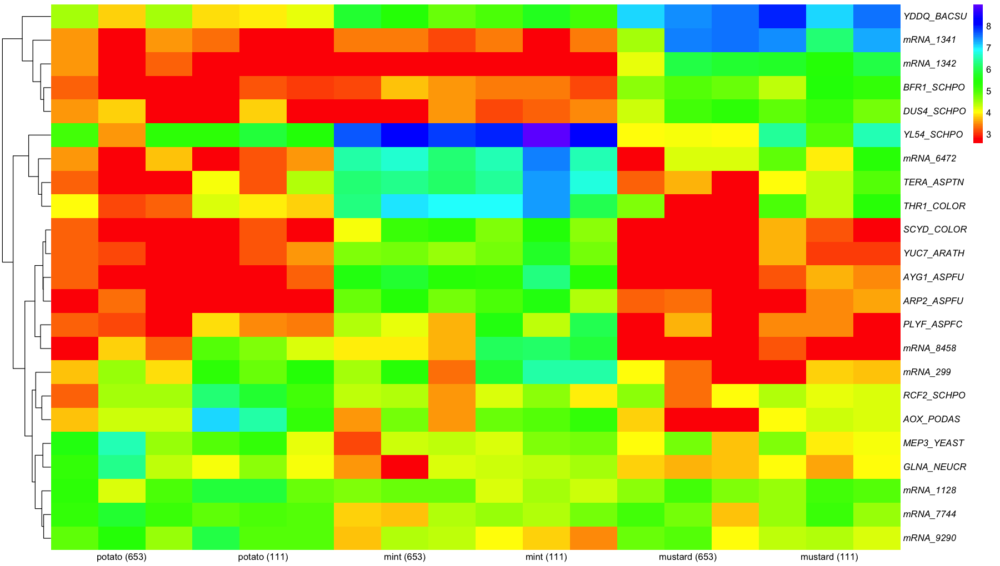

In [257]:
options(repr.plot.width=15, repr.plot.height=8.5)
Fungi_DEGs=pheatmap(hmDF,
  color= (rainbow(96,start=0.0,end=0.74,alpha=1)),
  border_color = NA,
  cluster_cols=F,                   
  show_colnames = TRUE,
  show_rownames = TRUE,
  labels_col=paste0(c(" ","potato (653)" ," "," ","potato (111)" ," ",
                            " ","mint (653)"   ," "," ","mint (111)"   ," ",
                            " ","mustard (653)"," "," ","mustard (111)"," ")),
  angle_col=0,
  labels_row = as.expression(newnames))

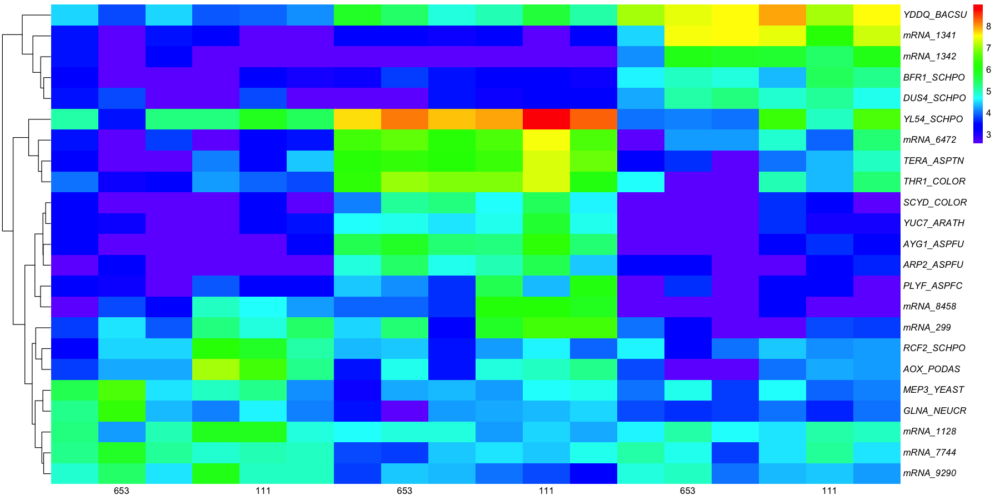

In [258]:
options(repr.plot.width=15, repr.plot.height=7.5)
Fungi_DEGs=pheatmap(hmDF,
        color= rev(rainbow(96,start=0.0,end=0.74,alpha=1)),#,s=1,v=0.6,start=0.5,end=0.01),
        border_color = NA,
        cluster_cols=F,
        show_colnames = TRUE,
        show_rownames = TRUE,
        labels_col=paste0(c(" ","653" ," "," ","111" ," ",
                            " ","653"   ," "," ","111"   ," ",
                            " ","653"," "," ","111"," ")),
        angle_col=0,
        labels_row = as.expression(newnames))

In [259]:
tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Verticillium_HeatMap_1.tiff",
     width = 8, height =5, units = 'in', res = 300)
Fungi_DEGs
dev.off()

pdf 
  2

Heatmap II

Object for heatmap

In [92]:
heat <- assay(rld)[diffXGenes,]

Convert to dataframe

In [93]:
hmDF = data.frame(heat)

Extract subset of genenames that are differentially expressed

* First, make new column of character gene IDs

In [94]:
gnDF["ID"] = as.character(gnDF$id)

* Differentially expressed genes

In [95]:
degs = subset(gnDF, gnDF$ID %in% rownames(hmDF))

* Use only unique/non duplicated rows

In [96]:
degs = degs[!duplicated(degs$ID),]

- Sanity checks

In [97]:
length(degs$ID) == length(rownames(hmDF))

[1] TRUE

In [98]:
class(degs$ID) == class(rownames(hmDF))

[1] TRUE

Reorder rows of both dataframes to align with each other

In [99]:
hmDF <- hmDF[with(hmDF, order(rownames(hmDF))), ]

In [100]:
degs <- degs[with(degs, order(degs$ID)), ]

* Sanity check

In [101]:
rownames(hmDF) == degs$ID

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[16] TRUE TRUE TRUE TRUE TRUE TRUE

Convert dataframe to matrix

In [102]:
hmdf = as.matrix(hmDF)

Replace rownames in heatmap object with gene names

In [103]:
rownames(hmdf) <- degs$Hit1_acc

Order row labels to italicize

In [105]:
ord_row_labs = rownames(hmdf)[(Fungal_DEGs$tree_row$order)]

In [106]:
ord_row_labs = cat(paste0('"', paste(ord_row_labs, collapse="\", \""), '"'))

"-", "BFR1_SCHPO", "DUS4_SCHPO", "-", "BFR1_SCHPO", "YDDQ_BACSU", "YL54_SCHPO", "-", "RCF2_SCHPO", "AOX_PODAS", "THR1_COLOR", "TERA_ASPTN", "-", "ALOX1_KOMPG", "LEPG_ASPFN", "-", "RTAI1_ARTBC", "AYG1_ASPFU", "-", "SQRD_AQUAE", "GSTO1_HUMAN"

- Italicize row names

In [115]:
newnames <- lapply(
  rownames(hmdf),
  function(x) bquote(italic(.(x))))

Visualize heatmap

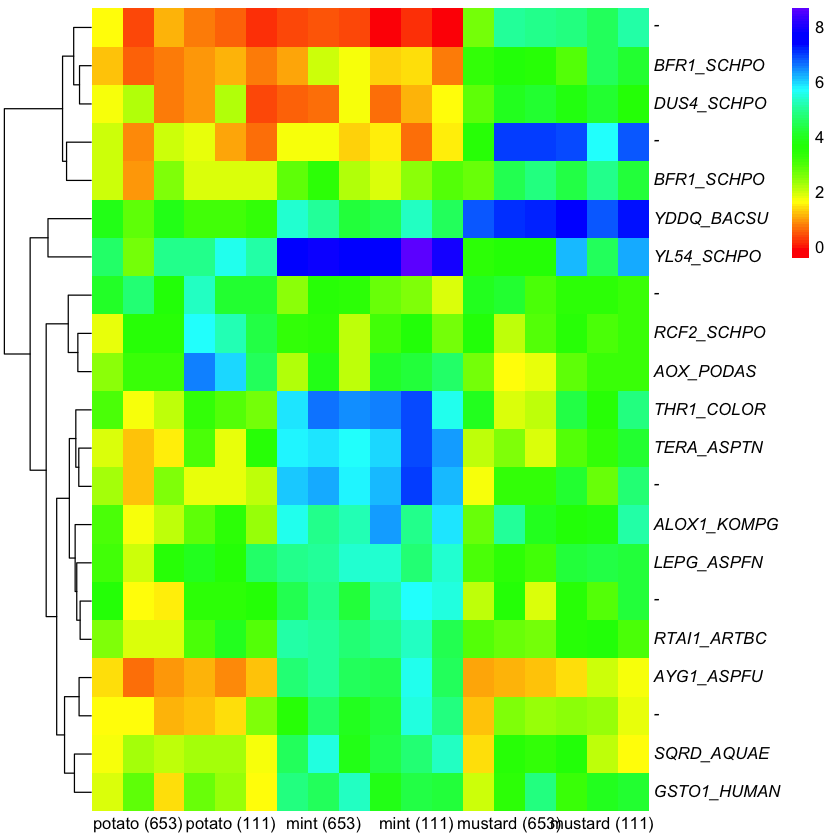

In [116]:
Fungal_DEGs=pheatmap(hmdf,
        color= (rainbow(96,start=0.0,end=0.74,alpha=1)),#,s=1,v=0.6,start=0.5,end=0.01),
        border_color = NA,
        show_colnames = TRUE,
        show_rownames = TRUE,
        cluster_cols = FALSE,
        labels_col=paste0(c(" ","potato (653)" ," "," ","potato (111)" ," ",
                            " ","mint (653)"   ," "," ","mint (111)"   ," ",
                            " ","mustard (653)"," "," ","mustard (111)"," ")),
        angle_col=0,
        labels_row = as.expression(newnames))


In [110]:
tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Verticillium_HeatMap_1.tiff",
     width = 8, height =5, units = 'in', res = 300)
Fungal_DEGs
dev.off()

pdf 
  2

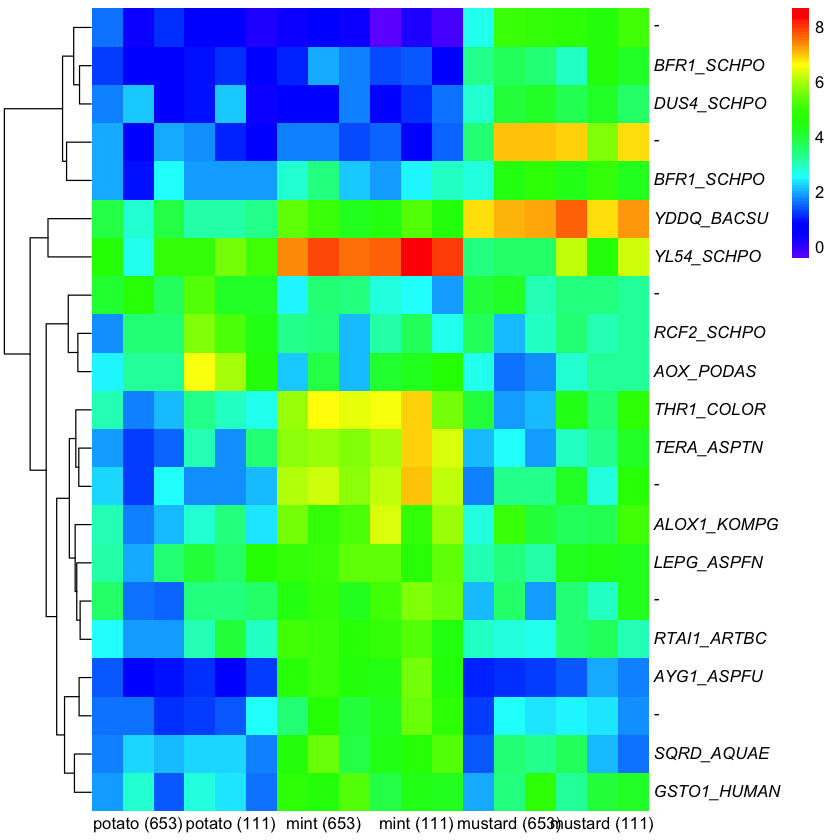

In [225]:
Fungal_DEGs=pheatmap(hmdf,
        color= rev(rainbow(96,start=0.0,end=0.74,alpha=1)),#,s=1,v=0.6,start=0.5,end=0.01),
        border_color = NA,
        show_colnames = TRUE,
        show_rownames = TRUE,
        cluster_cols = FALSE,
        labels_col=paste0(c(" ","potato (653)" ," "," ","potato (111)" ," ",
                            " ","mint (653)"   ," "," ","mint (111)"   ," ",
                            " ","mustard (653)"," "," ","mustard (111)"," ")),
        angle_col=0,
        labels_row = as.expression(newnames))

In [116]:
tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Verticillium_HeatMap_2.tiff",
     width = 8, height = 5, units = 'in', res = 300)
Fungal_DEGs
dev.off()

pdf 
  2

**Venn Diagrams**

**Comparisons between crops and within isolates**

S_653 ($Solanum\; tuberosum$) vs M_653 ($Mentha\; x\; piperita$)

In [92]:
resSig_M653vS653 = subset(M653vS653, padj < 0.001)
resSig_M653vS653_fragments = row.names(resSig_M653vS653)

S_653 ($Solanum\; tuberosum$) vs B_653 ($Brassica\; juncea$)

In [93]:
resSig_B653vS653 = subset(B653vS653, padj < 0.001)
resSig_B653vS653_fragments = row.names(resSig_B653vS653)

S_111 ($Solanum\; tuberosum$) vs M_111 ($Mentha\; x\; piperita$)

In [94]:
resSig_S111vM111 = subset(S111vM111, padj < 0.001)
resSig_S111vM111_fragments = row.names(resSig_S111vM111)

B_111 ($Brassica\; juncea$) vs M_111 ($Mentha\;x\;piperita$)

In [95]:
resSig_B111vM111 = subset(B111vM111, padj < 0.001)
resSig_B111vM111_fragments = row.names(resSig_B111vM111)

Venn Diagram for publication

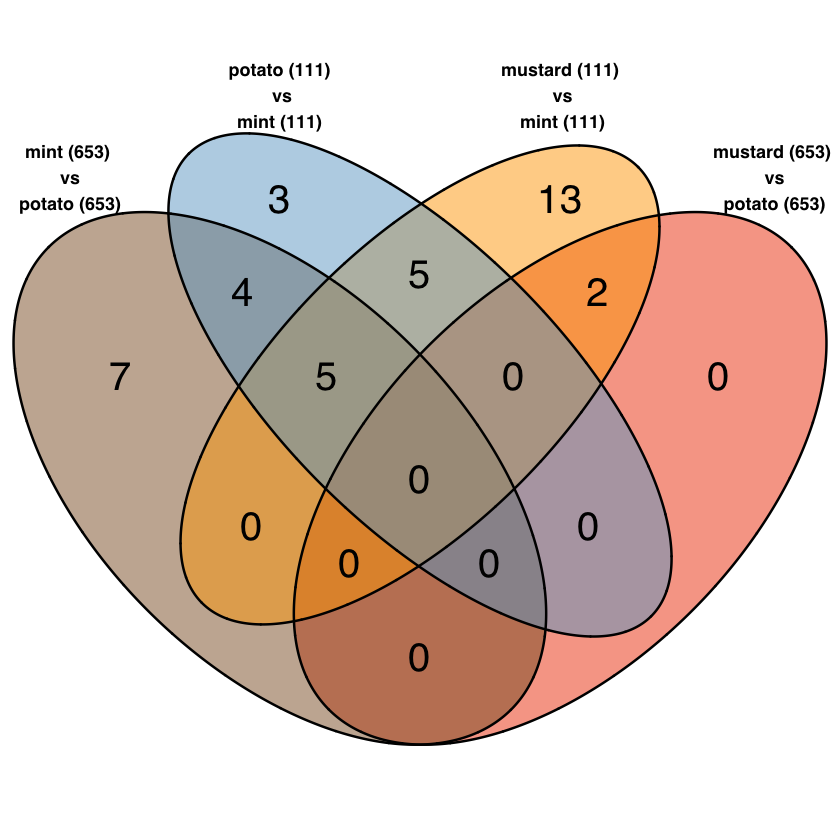

In [106]:
#tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Hosts_VD.tiff",
 #    width=15, height=15, units = 'in', res = 300)
venn.plot = venn.diagram(list(resSig_M653vS653$id,
                              resSig_B653vS653$id,
                              resSig_S111vM111$id,
                              resSig_B111vM111$id),
            filename=NULL, 
            category.names=c("mint (653)\n vs\n potato (653)",
                             "mustard (653)\n vs\n potato (653)",
                             "potato (111)\n vs\nmint (111)",
                             "mustard (111)\n vs\n mint (111)"),
            fill=c("tan4","orangered2","skyblue3","orange1"),
            alpha=c(0.5,0.5,0.5,0.5),
            cex=2,fontfamily = "sans",
            cat.cex=0.9, cat.fontface="bold", cat.fontfamily = "sans", 
            euler.d = TRUE, scaled = FALSE,
            height = 3000, width = 3000, 
            resolution = 500, imagetype = "tiff")

grid.draw(venn.plot)
#dev.off()

Sanity checks

In [162]:
7+4+5 == length(resSig_M653vS653$id)

[1] TRUE

In [163]:
2 == length(resSig_B653vS653$id)

[1] TRUE

In [164]:
3+4+5+5 == length(resSig_S111vM111$id)

[1] TRUE

In [165]:
13+2+5+5 == length(resSig_B111vM111$id)

[1] TRUE

**Comparisons between isolates and within crops**

S_111 ($Solanum\; tuberosum$) vs S_653 ($Solanum\; tuberosum$) 

In [166]:
resSig_S111vS653 = subset(S111vS653, padj < 0.001)
resSig_S111vS653_fragments = row.names(resSig_S111vS653)

M_653 ($Mentha\;x\;piperita$) vs M_111 ($Mentha\;x\;piperita$)

In [167]:
resSig_M653vM111 = subset(M653vM111, padj < 0.001)
resSig_M653vM111_fragments = row.names(resSig_M653vM111)

B_111 ($Brassica\;juncea$) vs B_653 ($Brassica\;juncea$)

In [168]:
resSig_B111vB653 = subset(B111vB653, padj < 0.001)
resSig_B111vB653_fragments = row.names(resSig_B111vB653)

Venn Diagram for publication

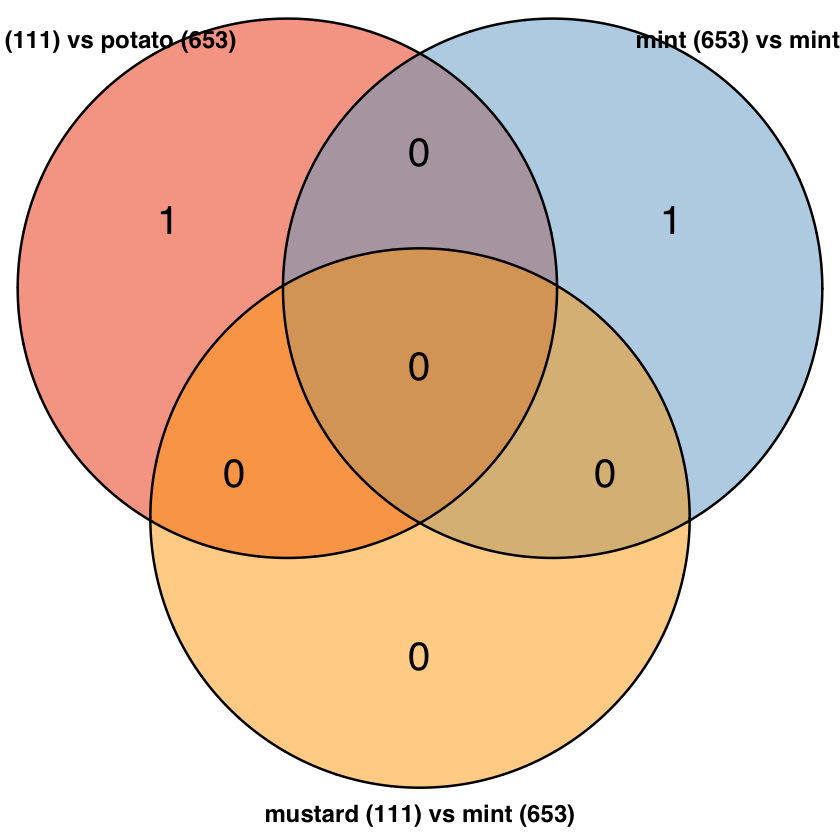

In [179]:
# tiff("/Users/davidwheeler/Desktop/RESEARCH/Data/TRANSCRIPTOMICS/FIGURES/Verticillium_dahliae/Isolate_VD.tiff",
#     width=15, height=15, units = 'in', res = 300)
venn.plot = venn.diagram(list(resSig_S111vS653$id,
                              resSig_M653vM111$id,
                              resSig_B111vB653$id),
            filename=NULL, 
            category.names=c("   potato (111) vs potato (653)",
                             "mint (653) vs mint (111)",
                             "mustard (111) vs mint (653)"),
            fill=c("orangered2","skyblue3","orange1"),
            alpha=c(0.5,0.5,0.5),
            cex=2,fontfamily = "sans",
            cat.cex=1.2, cat.fontface="bold", cat.fontfamily = "sans", 
            euler.d = TRUE, scaled = FALSE,
            height = 3000, width = 3000, 
            resolution = 500, imagetype = "tiff")

grid.draw(venn.plot)
# dev.off()

Sanity checks

In [180]:
1 == length(resSig_S111vS653$id)

[1] TRUE

In [181]:
1 == length(resSig_M653vM111$id) 

[1] TRUE

In [182]:
0 == length(resSig_B111vB653$id) 

[1] TRUE

### Export data<a class="anchor" id="twelveth-q"></a>  
[Back to Table of Contents](#toc-q)

* Control vs. 653

In [128]:
?read.csv()

In [ ]:
write.csv(as.data.frame(resSig_Cv653), 
          file="Mentha_DEGs_Cv653.csv")

* Control vs. 111

In [ ]:
write.csv(as.data.frame(resSig_Cv111), 
          file="Mentha_DEGs_Cv111.csv")

* 653 vs 111

In [ ]:
write.csv(as.data.frame(resSig_653v111), 
          file="Mentha_DEGs_653v111.csv")

### Graveyard<a class="anchor" id="thirteenth-q"></a>  
[Back to Table of Contents](#toc-q)

In [ ]:
# For each sample/row in the sample column
for (row in DF$Sample){
    # Split the sample by the underscore
    sample = strsplit(row,"_")
    # If sample contains S2, 
    if (grepl("S2",sample)){
    }
}

### Resources<a class="anchor" id="fourteenth-q"></a>  
[Back to Table of Contents](#toc-q)

 * R kernel installation: https://irkernel.github.io/installation/
 * DESeq2 installation: https://anaconda.org/bioconda/bioconductor-deseq2
 * DESeq2 data curation: https://www.bioconductor.org/packages/devel/bioc/vignettes/DEFormats/inst/doc/DEFormats.html
 * DESeq2 vignette: 
 http://bioconductor.org/packages/devel/bioc/vignettes/DESeq2/inst/doc/DESeq2.html
 http://master.bioconductor.org/packages/release/workflows/vignettes/rnaseqGene/inst/doc/rnaseqGene.html
 * Volcano plots: https://rdrr.io/github/kevinblighe/EnhancedVolcano/f/README.md
     * https://www.bioconductor.org/packages/release/bioc/vignettes/EnhancedVolcano/inst/doc/EnhancedVolcano.html
 